# Multi-Layer Neural Network and Convolutional Neural Network

In this project, a custom implemented multi-layer neural network is compared with the VGG19 convolutional neural network provided by the PyTorch library. Additionally, concepts such as optimizing neural networks and tuning hyperparameters are explored, and the results are compared.

# Part 1: Multi-Layer Neural Network

## Preprocessing

### Loading the Data
Load Images from drive, and save them as gray-scale matrices.

In [ ]:
import cv2
import os
import numpy as np
import pandas as pd
import math
import seaborn as sns

from google.colab.patches import cv2_imshow

from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
'''simple method, loads images from the '''
def load_images(folder_path):
    images = []
    labels = []
    for flower_specie in os.listdir(folder_path):
        flower_specie_path = os.path.join(folder_path, flower_specie)
        if os.path.isdir(flower_specie_path):
            for flower_name in os.listdir(flower_specie_path):
                img_path = os.path.join(flower_specie_path, flower_name)
                img = cv2.imread(img_path)
                if img is not None:
                    images.append(img)
                    labels.append(flower_specie)
    return np.array(images), np.array(labels)

# Define folder paths
train_folder = '/content/drive/MyDrive/flowers15/train'
validation_folder = '/content/drive/MyDrive/flowers15/val'
test_folder = '/content/drive/MyDrive/flowers15/test'

# Load images and labels for train, validation, and test
train_images, train_labels = load_images(train_folder)
validation_images, validation_labels = load_images(validation_folder)
test_images, test_labels = load_images(test_folder)



print(f"Number of images in train set: {len(train_images)}")
print(f"Number of images in validation set: {len(validation_images)}")
print(f"Number of images in test set: {len(test_images)}")


<ipython-input-2-83d2003453a3>:14: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  return np.array(images), np.array(labels)


Number of images in train set: 10510
Number of images in validation set: 2250
Number of images in test set: 2250


Normalize the greyscale values.

In [ ]:
g_images = []           #this will contain all our images in greyscale

#a simple function that converts an image to it's grayscale.

convert_img = lambda img, size = (64,64) : (cv2.cvtColor(cv2.resize(img, size), cv2.COLOR_BGR2GRAY))

for images_np in [train_images, validation_images, test_images]:
    g_images.append(np.array([convert_img(img) for img in images_np]))

g_images_normalized = [g_image/255 for g_image in g_images]

### Encode Objects
The label classes are encoded as numbers with the below procedure in order to prepare a dataset that can be used as an input to a neural network. Later, a one-hot conversion of these values will be enacted so that they may best serve our purposes.

Additionally, the input objects are flattened so that they may be fed into neural networks, with each 'pixel' now being considered a feature.

In [ ]:
#encode dictionary for the conversion labels to numbers from 0 to len(labels)
encoding = 0
encode_dict = {}
for clas in np.unique(train_labels):
    encode_dict[clas]= encoding
    encoding+=1

In [ ]:
#converts string labels to number-encoded
encode = lambda np_arr : np.array([encode_dict[clas] for clas in np_arr])
#reduce a matrix to 1d
flatten = lambda np_arr : np.array([np_ar.flatten() for np_ar in np_arr])

X_train = flatten(g_images_normalized[0])
X_val = flatten(g_images_normalized[1])
X_test = flatten(g_images_normalized[2])
Y_train = encode(train_labels)
Y_val = encode(validation_labels)
Y_test = encode(test_labels)

One hot encoder.

In [ ]:
num_classes = len(np.unique(Y_train))

#one-hot converter
def one_hot(num, numc = num_classes):
    one_hot_arr = np.zeros(numc)
    one_hot_arr[num] = 1
    return one_hot_arr

In [ ]:
# Convert labels to one-hot encoding
Y_train_one_hot = np.array([one_hot(y) for y in Y_train])
Y_val_one_hot = np.array([one_hot(y) for y in Y_val])
Y_test_one_hot = np.array([one_hot(y) for y in Y_test])

## Coding the Neural Network

### Useful functions

The sigmoid function introduces non-linearity in neural networks by mapping inputs to values between 0 and 1, crucial for activation. Its derivative aids in weight adjustments during training. The softmax function, essential for multiclass classification, transforms inputs into probability distributions. ReLU and tanh are activation functions as well. Some precautions are taken to maintain numerical stability, ensuring reliable performance.

In [ ]:
def sigmoid(x):
    x = np.clip( x, -500, 500 )
    return 1 / (1 + np.exp(-x))

def sigmoid_derivative(x):
    return sigmoid(x) * (1 - sigmoid(x))

def softmax(inputs):
    #print(inputs)
    expo_vals = np.exp(inputs-np.max(inputs))#, axis=1, keepdims = True))  #keep inputs below zero as to avoid numerical overflow
    #normalize
    return expo_vals / np.sum(expo_vals)#, axis=1, keepdims = True)


def softmax_derivative(output):
    """Compute the derivative of the softmax function.
    Args:
        output (ndarray): The output of the softmax function.
    Returns:
        ndarray: The derivative of the softmax function.
    """
    softmax_output = softmax(output)
    return softmax_output * (1 - softmax_output)

In [ ]:
def relu(x):
    """ReLU (Rectified Linear Unit) activation function."""
    return np.maximum(0, x)

def relu_derivative(x):
    """Derivative of ReLU activation function."""
    return np.where(x > 0, 1, 0)

def tanh(x):
    """Hyperbolic tangent (tanh) activation function."""
    return np.tanh(x)

def tanh_derivative(x):
    """Derivative of hyperbolic tangent (tanh) activation function."""
    return 1 - np.tanh(x)**2

The negative_log_likelihood method calculates the loss between predicted and true values for one-hot encoded vectors. It employs numpy operations for numerical stability and returns the negative logarithm of the sum of element-wise multiplication between the clipped predicted values and the true values.









In [ ]:
def negative_log_likelihood(y_pred, y_tru):#y_tru vectors in one-hot format
    y_prep_clipped = np.clip(y_pred, 1e-9, 1-1e-9)
    L_sum = np.sum(y_prep_clipped * y_tru)#, axis = 1)
    return -1*np.log(L_sum)

### Neural Network Proper

A layer class is initially defined, which accepts inputs, stores weights and biases, and derivatives associated with these, and computes an output with a specified activation function (which could be tanh, sigmoid, or relu).

In [ ]:
class Layer:
    def __init__(self, n_inputs, n_neurons):
        np.random.seed(42)
        self.weights = np.random.randn(n_inputs, n_neurons)             #already transposed, weights associated with inputs
        self.biases = np.zeros(n_neurons)                               #1 bias fore each neuron
        self.derivatives = np.zeros((n_inputs, n_neurons))              #1 derivative for each weight
        self.derivatives_biases = np.zeros(n_neurons)

    def forward(self,inputs, activation_function=sigmoid):
        self.activation = np.dot(inputs, self.weights) + self.biases
        self.output = activation_function(self.activation)
        return self.output

Allows specification of the number of input nodes, hidden layer sizes, and output nodes, along with activation and derivative functions. The class supports forward propagation, backpropagation, and gradient descent for training purposes. Notably, the last layer utilizes softmax activation to accommodate multi-class classification problems. The training method employs mini-batch processing, and a learning rate decay mechanism is integrated to enhance convergence.






In [ ]:
class NeuralNetwork:
    def __init__(self, num_inputs=3, hidden_layers=[3, 3], num_outputs=2, activation_function = sigmoid, derivative_function = sigmoid_derivative):
        self.activation_function = activation_function
        self.derivative_function = derivative_function
        self.num_inputs = num_inputs
        self.hidden_layers = hidden_layers
        self.num_outputs = num_outputs

        self.layers = []                          #this list contains the layers of this neural network, after the input layer
        j=num_inputs                              #j: num inputs to current layer in the loop. starting from the first hidden layer.
        for i in hidden_layers + [num_outputs]:   #i: num neurons in layer
            self.layers.append(Layer(j, i))
            j = i

    def forward_propagation(self, inputs):
        self.inputs = inputs                #'activations' of the first layer

        activations = [inputs]

        input = self.inputs                 #our loop variable, always the input to the current layer
        for i in range(len(self.layers)):   #loop through the layers
            layer = self.layers[i]
            input = layer.forward(input, self.activation_function if not i==len(self.layers)-1 else softmax) #we use softmax for the last layer
            activations.append(input)
        self.activations = activations
        return activations[-1]        #return the output layer

    def back_propagation(self, error):
        """
        Backpropagate the error signal.
        """

        #apply softmax derivative function from here, therefore do the last layer's operations manually.
        lyr = self.layers[-1]       #the output layer
        delta = error * softmax_derivative(lyr.output)

        lyr.derivatives = np.dot(np.transpose([self.activations[-2]]), [delta])     #self.activations[-2]   :   input to the last layer
        lyr.derivatives_biases = delta
        error = np.dot(delta, lyr.weights.T)

        # iterate backwards through the network layers
        for i in reversed(range(len(self.layers)-1)):
            lyr = self.layers[i]

            # apply the derivative of the activation function
            delta = error * self.derivative_function(lyr.output)
            input_to_curr_layer = self.activations[i]

            # save derivative after applying matrix multiplication
            lyr.derivatives = np.dot(np.transpose([input_to_curr_layer]), [delta])
            lyr.derivatives_biases = delta
            # backpropogate the next error
            error = np.dot(delta, lyr.weights.T)

    def gradient_descent(self, learning_rate=0.05):
        """Learns by descending the gradient
        """
        # update the weights by stepping down the gradient
        for lyr in self.layers:
            lyr.weights = lyr.weights + lyr.derivatives * learning_rate
            lyr.biases = lyr.biases + lyr.derivatives_biases * learning_rate

    def train(self, inputs, targets, epochs, learning_rate, batch_size, decay_rate = 0.02):
        """Trains model running forward and backward propagation.
        In batches.
        Calculate error vectors for all members of a batch. Average it. Update the network
        with backpropagation and gradient descent.
        Return the errors that they may be plotted.

        Utilizes decay.
        """
        errors=[]
        # now enter the training loop
        for epoch in range(epochs):
            sum_errors = 0
            average_batch_error = 0
            batch_error = 0

            num_samples = len(inputs)

            for i in range(0, num_samples, batch_size):
                # Extract a mini-batch
                inputs_batch = inputs[i:i+batch_size]
                targets_batch = targets[i:i+batch_size]

                batch_error = 0

                for input_item, target_item in zip(inputs_batch, targets_batch):
                    # Forward propagation
                    output = self.forward_propagation(input_item)     #output, this is the output out of the last layer
                    # Calculate error
                    error = target_item - output

                    batch_error+= error
                    batch_loss = negative_log_likelihood(output, target_item)


                average_batch_error = batch_error / len(inputs_batch)
                # Backward propagation
                self.back_propagation(average_batch_error)                       #populate dL/dW vals.
                # Gradient descent
                self.gradient_descent(learning_rate)

                sum_errors += batch_loss / len(inputs_batch)

            learning_rate *= 1 / (1 + decay_rate * epoch)

            #print(f"EPOCH{epoch}!")
            #print(f"average error:\t{sum_errors / (num_samples // batch_size)}")

            errors.append(sum_errors / (num_samples // batch_size))
        print("Training complete!")
        print("=====")
        return errors



### Using the network for predictions.



In [ ]:
#predict
def predict(X_test, neural_network):
    results = neural_network.forward_propagation(X_test)
    Y_pred = np.zeros(results.shape[0])
    for i,result_v in enumerate(results):
        Y_pred[i]=np.argmax(result_v)
    return Y_pred

## The Experiments And The Rest Of The Report

### Output Generation
Experiment details:

Network size:

*single layer neural network, 1 hidden layer, 2 hidden layers.*

Activation functions:

*relu, tanh, sigmoid functions available for use.*

Implementation details:

*learning rate between 0.005, 0.02    :We test 0.0075, 0.015 for convenience.*

*batch size between 16, 128           :We test 32, 96 for convenience and time constraints.*

In [ ]:
#single layer neural network, 1 hidden layer, 2 hidden layer
#relu, tanh, sigmoid
#learning rate between 0.005, 0.02    :0.0075, 0.015
#batch size between 16, 128           :32, 96
func_name_list = ["sigmoid", "relu", "tanh"]
func_list = [sigmoid, relu, tanh]
func_derivative_list = [sigmoid_derivative, relu_derivative, tanh_derivative]
learning_rates = [0.0075, 0.015]
batch_sizes = [32, 96]


In [ ]:
from sklearn.metrics import classification_report
from sklearn import metrics

Below loop performs 12 experiments for each of the three activation functions available, and stores the results.

In [ ]:
errors_all = []
reports_all = []
for i,func in enumerate(func_list):
    errors = []
    reports = []
    activation_function,derivative_function = func, func_derivative_list[i]
    my_nn_list = [NeuralNetwork(64*64, [], num_classes,activation_function, derivative_function),
                  NeuralNetwork(64*64, [64*4], num_classes,activation_function, derivative_function),
                  NeuralNetwork(64*64, [64*4, 64], num_classes,activation_function, derivative_function)]
    for j,nn in enumerate(my_nn_list):
            print(f"{j} HIDDEN LAYERS")
            for learning_rate in learning_rates:
                for batch_size in batch_sizes:
                    errors.append(nn.train(X_train, Y_train_one_hot, 10, learning_rate, batch_size))
                    Y_pred = predict(X_test, nn)
                    clas_report = classification_report(Y_test, Y_pred,output_dict = True)
                    reports.append(clas_report)
                    #print(f"learning_rate = {learning_rate}\nbatch_size = {batch_size}:\n{classification_report(Y_test, Y_pred)}")
    errors_all.append(errors)
    reports_all.append(reports)

### Ploting Loss

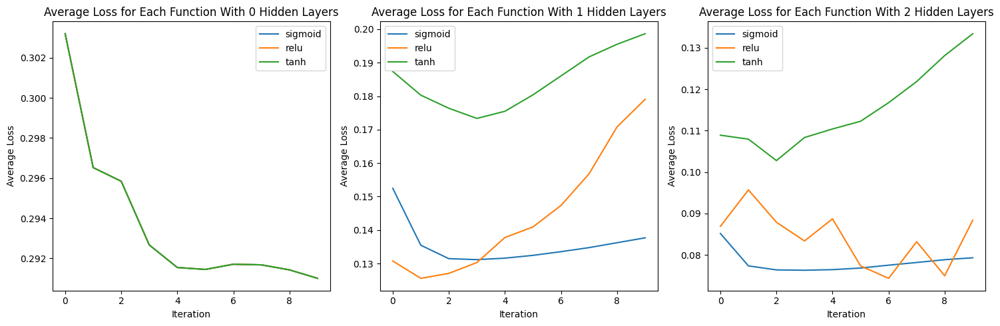

In [ ]:
import matplotlib.pyplot as plt

losses = np.array(errors_all)
losses_0_hidden_layer = losses[:, :4, :]
losses_1_hidden_layer = losses[:, 4:8, :]
losses_2_hidden_layer = losses[:, 8:, :]

# Calculate the average along the axis corresponding to the 12 losses
average_losses_0 = np.mean(losses_0_hidden_layer, axis=1)
average_losses_1 = np.mean(losses_1_hidden_layer, axis=1)
average_losses_2 = np.mean(losses_2_hidden_layer, axis=1)

# Create a figure with three subplots
fig, axs = plt.subplots(1, 3, figsize=(15, 5))

# Plot for average_losses_0
for i in range(3):
    axs[0].plot(average_losses_0[i], label=func_name_list[i])

# Plot for average_losses_1
for i in range(3):
    axs[1].plot(average_losses_1[i], label=func_name_list[i])

# Plot for average_losses_2
for i in range(3):
    axs[2].plot(average_losses_2[i], label=func_name_list[i])

# Set common labels and title
for i, ax in enumerate(axs):
    ax.set_xlabel('Iteration')
    ax.set_ylabel('Average Loss')
    ax.set_title(f'Average Loss for Each Function With {i} Hidden Layers')
    ax.legend()

# Adjust layout for better spacing
plt.tight_layout()
plt.show()

Above average loss plots of our experiments are observed. With 0 hidden layers, it is noted that all functions appear to have followed the same 'path' in minimizing loss, which in reality is more attributed to them using the same output function (softmax) than anything else. In the scenario with 0 hidden layers, there are no internal functions to complicate the calculations.

Now, regarding the other two tables, it appears that some problem has been encountered, most likely in the backpropagation and gradient descent phases, such that currently these procedures do not significantly improve performance, nor do they aid in minimizing loss. Sigmoid can be singled out as being more stable.

### The Table
Below is a table displaying the results of our experiments. One thing to bear in mind is that our models always seem to perform with an accuracy ranging between 5 to 10 percent, which is very low. The reason for this is attributed to the shortcomings of our backpropagation function. However, even though our model isn't performing well, the results it produces are still influenced by the set of hyperparameters passed into it. Soon, an examination of these hyperparameters will be attempted as thoroughly as possible. But for now, the code below will be explained:

The table is created with pandas, with appropriate features. Then, dictionaries stored in the output generation section above are extracted, and the table is populated with the matching values, as well as others obtained by different means.

In [ ]:
import pandas as pd

columns = ["Function Name", "Number of Hidden Layers", "Learning Rate", "Batch Size", "Accuracy", 'Precision','Recall','F1-Measure']
my_table = pd.DataFrame(columns=columns)
data = {
    "Function Name": "some",
    "Number of Hidden Layers": 2,
    "Learning Rate": 0.01,
    "Batch Size": 32,
    "Accuracy": 0.95,
    'Precision':0.1
}
for i,func in enumerate(func_name_list):
    j = 0
    data['Function Name'] = func        #will be the next entry in our table
    for num_hidden_layers in range(3):
            data["Number of Hidden Layers"] = num_hidden_layers
            for learning_rate in learning_rates:
                data['Learning Rate'] = learning_rate
                for batch_size in batch_sizes:
                    data['Batch Size'] = batch_size
                    data['Accuracy'] = reports_all[i][j]['accuracy']
                    data['Precision'] = reports_all[i][j]['weighted avg']['precision']
                    data['Recall'] = reports_all[i][j]['weighted avg']['recall']
                    data['F1-Measure'] = reports_all[i][j]['weighted avg']['f1-score']
                    #append to table
                    my_table.loc[len(my_table)] = data

                    #update index
                    j+=1


In [ ]:
"""stylize the table where we keep the records."""
def style_df(df):
    return df.style \
        .set_table_styles([
            {'selector': 'thead th', 'props': [('background-color', 'lightgrey')]},
            {'selector': 'tbody tr:nth-child(even)', 'props': [('background-color', 'whitesmoke')]},
            {'selector': 'tbody tr:nth-child(odd)', 'props': [('background-color', 'white')]},
            {'selector': 'th, td', 'props': [('border', '1px solid grey')]},
        ])

# Display the styled DataFrame
styled_table = style_df(my_table)
styled_table

,Function Name,Number of Hidden Layers,Learning Rate,Batch Size,Accuracy,Precision,Recall,F1-Measure
0,sigmoid,0,0.007500,32,0.074222,0.071424,0.074222,0.068868
1,sigmoid,0,0.007500,96,0.076889,0.069969,0.076889,0.071943
2,sigmoid,0,0.015000,32,0.080444,0.070883,0.080444,0.068162
3,sigmoid,0,0.015000,96,0.088889,0.079293,0.088889,0.081830
4,sigmoid,1,0.007500,32,0.076444,0.078939,0.076444,0.071997
5,sigmoid,1,0.007500,96,0.078667,0.079667,0.078667,0.077743
6,sigmoid,1,0.015000,32,0.090667,0.089220,0.090667,0.074352
7,sigmoid,1,0.015000,96,0.098667,0.097574,0.098667,0.094111
8,sigmoid,2,0.007500,32,0.069333,0.080556,0.069333,0.060403
9,sigmoid,2,0.007500,96,0.074222,0.080150,0.074222,0.074338


The table above presented encapsulates the outcomes of various experiments, exploring the impact of different parameters on neural network performance. The results are organized by function name, number of hidden layers, learning rate, and batch size, with metrics such as accuracy and precision providing insights into model effectiveness.

For the sigmoid activation function with zero hidden layers, there appears to be a marginal improvement in accuracy with higher learning rates, especially evident with a batch size of 96. However, precision values remain relatively consistent across different configurations, suggesting limited sensitivity to these variations.

Moving to the scenario with one hidden layer, the sigmoid function displays improved performance, particularly with a learning rate of 0.015 and a batch size of 96, where both accuracy and precision exhibit noticeable enhancements.

The situation changes when considering the ReLU activation function. Interestingly, with one hidden layer and a learning rate of 0.0075, there is a significant drop in accuracy, especially notable with larger batch sizes. This hints at potential challenges in convergence or gradient-related issues with this particular configuration.

The tanh activation function follows a pattern similar to sigmoid, with improvements in accuracy and precision observed with one hidden layer and higher learning rates. Notably, a learning rate of 0.015 consistently yields better results across different batch sizes.

### Visualization


In [ ]:
my_nn = NeuralNetwork(64*64, [], num_classes,sigmoid, sigmoid_derivative)
my_nn.train(X_train, Y_train_one_hot, 10, 0.015, 32)

In [ ]:
reshaped_matrices = my_nn.layers[0].weights.T.reshape((15, 64, 64))
reshaped_matrices/=reshaped_matrices.max()
reshaped_matrices = reshaped_matrices + 1
reshaped_matrices *= (255/2)
reshaped_matrices.max()

255.0

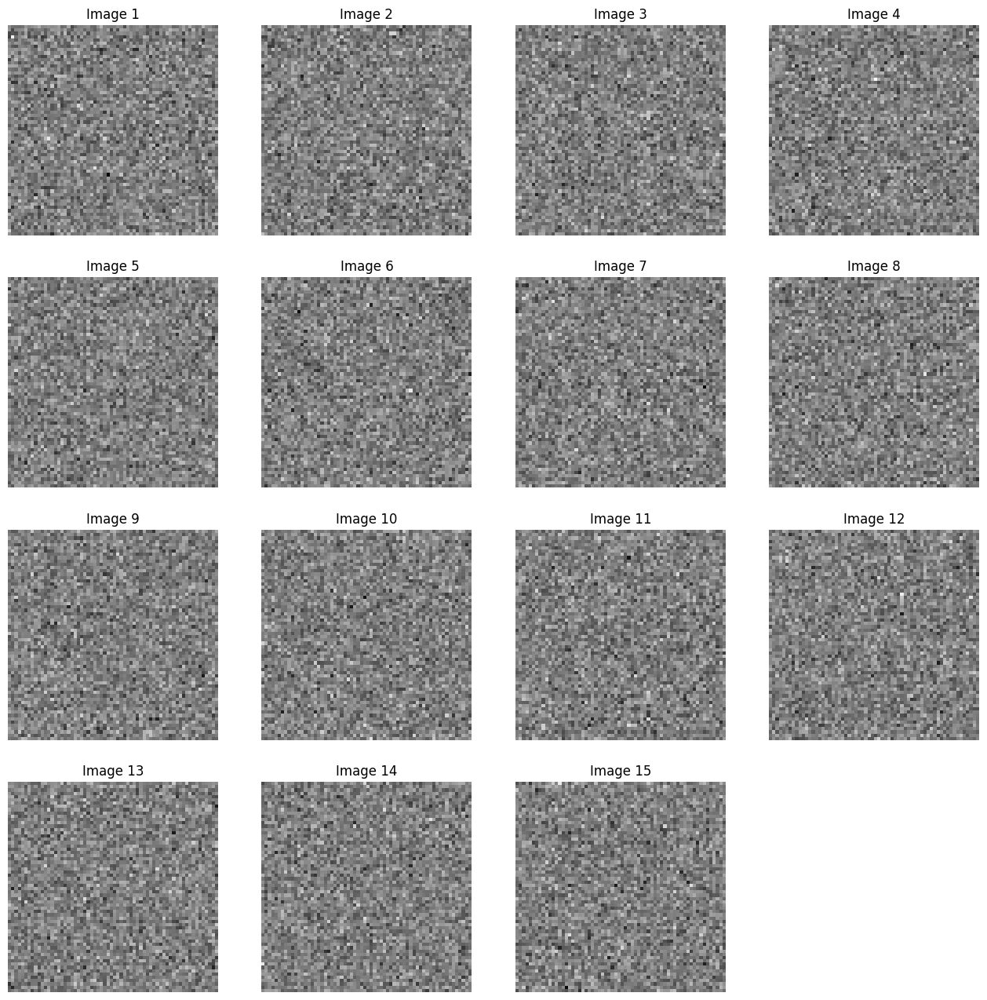

In [ ]:
int_images = reshaped_matrices.astype(int)

# Set up the plot with a 4x4 grid
num_images = int_images.shape[0]
num_rows = num_images // 4 + (num_images % 4 > 0)
num_cols = min(4, num_images)
fig, axes = plt.subplots(num_rows, num_cols, figsize=(16, 4 * num_rows))

# Display the grayscale images side by side
for i in range(num_images):
    row_idx = i // 4
    col_idx = i % 4
    axes[row_idx, col_idx].imshow(int_images[i], cmap='gray', vmin=0, vmax=255)
    axes[row_idx, col_idx].set_title(f"Image {i + 1}")
    axes[row_idx, col_idx].axis('off')

# Remove empty subplots if needed
for i in range(num_images, num_rows * num_cols):
    row_idx = i // 4
    col_idx = i % 4
    fig.delaxes(axes[row_idx, col_idx])

plt.show()

# Part 2: Convolutional Neural Network

Import Modules

In [ ]:
#import cv2
#import os
import numpy as np
import pandas as pd
#import math
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score, precision_score, recall_score, f1_score
import torch
import torchvision.models as models
import torchvision.transforms as transforms
from torch.utils.data import DataLoader#, Dataset
from torchvision.datasets import ImageFolder
import torch.nn as nn
import torch.optim as optim
import time
import torchvision

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

## Load Dataset

In [ ]:
# Define transformations for dataset
transform = transforms.Compose([
    transforms.Resize((256, 256)),
    transforms.RandomResizedCrop(224),
    transforms.ToTensor(),
])

# Load your dataset using ImageFolder
train_dataset = ImageFolder(root=r'C:\Users\oguzh\Desktop\flowers15/train', transform=transform)
valid_dataset = ImageFolder(root=r'C:\Users\oguzh\Desktop\flowers15/val', transform=transform)
test_dataset = ImageFolder(root=r'C:\Users\oguzh\Desktop\flowers15/test', transform=transform)

## Performance Metrics Calculation and Visualization Functions

In [ ]:
# Calculate and Print Confusion Matrix
def calc_conf_matrix(true, pred, title, color):
    # Calculate confusion matrix
    conf_matrix = confusion_matrix(true, pred)

    # Display the confusion matrix using seaborn
    plt.figure(figsize=(5, 4))
    sns.heatmap(conf_matrix, annot=True, fmt='d', cmap=color, xticklabels=test_dataset.classes, yticklabels=test_dataset.classes)
    plt.xlabel('Predicted Labels')
    plt.ylabel('True Labels')
    plt.title(title)
    plt.show()


# Calculate and Print Performance Metrics
def calc_perf_metrics(true, pred, correct, total):
    # Calculate accuracy, precision, recall, f1-score
    accuracy = correct / total * 100
    precision = precision_score(true, pred, average='weighted', zero_division=0) * 100
    recall = recall_score(true, pred, average='weighted') * 100
    f1 = f1_score(true, pred, average='weighted') * 100

    print(f'Accuracy: {accuracy:.2f}%')
    print(f'Precision: {precision:.2f}, Recall: {recall:.2f}, F1 Score: {f1:.2f}')

    return accuracy, precision, recall, f1


# Print All Performance Metrics
def print_metrics(labels, train_metrics, val_metrics, test_metrics):
    metrics_data = [train_metrics, val_metrics, test_metrics]
    metrics_labels = ['Train', 'Validation', 'Test']

    metrics_df = pd.DataFrame(metrics_data, columns=labels, index=metrics_labels)

    # Create a heatmap using Seaborn
    plt.figure(figsize=(6, 3))
    sns.heatmap(metrics_df, annot=True, cmap='Reds', fmt=".2f", linewidths=.5)
    plt.title('Performance Metrics')
    plt.show()

## Train and Eval Functions

### Train VGG-19

The provided code defines a training function, train_vgg19, designed for training a VGG-19 model on a specified dataset. The function takes parameters for learning rate (lr), weight decay (wd), an index for tracking purposes (idx), the number of classes in the dataset (num_classes), and a boolean flag (task2). The boolean flag controls whether the function performs the first or second task of Part 2.

If task2 is True, the function fine-tunes only the last two fully connected layers of the VGG-19 model. It freezes all other layers and replaces the fourth and sixth layers of the classifier with new linear layers. If task2 is False, the function fine-tunes all the weights in the model but only replaces the last fully connected layer.

The training process involves defining a loss function, an optimizer with a learning rate scheduler, and then training the model for a specified number of epochs. The function prints training loss and performance metrics, such as accuracy, precision, recall, and F1-score, at each epoch. Finally, it saves the trained model and returns relevant information, including the trained model itself and the performance metrics.

In [ ]:
def train_vgg19(train, lr, wd, idx, num_classes, task2):
    # Keep track of training time
    train_time = time.time()

    # Load the VGG-19 model
    vgg19 = models.vgg19(weights= models.VGG19_Weights.IMAGENET1K_V1)

    # Move the model to GPU if available
    vgg19 = vgg19.to(device)

    if task2:
        # Second ttask of Part 2, Fine-tune only the last two fully connected layers
        for param in vgg19.parameters():
            param.requires_grad = False
        vgg19.classifier[4] = nn.Linear(4096, 4096)  # Replacing FC1
        vgg19.classifier[6] = nn.Linear(4096, num_classes)  # Replacing FC2
        vgg19.classifier[4] = vgg19.classifier[4].to(device)
        vgg19.classifier[6] = vgg19.classifier[6].to(device)
    else:
        # First task of Part 2, Fine-tune all weights
        vgg19.classifier[6] = nn.Linear(4096, num_classes)
        vgg19.classifier[6] = vgg19.classifier[6].to(device)

    # Define loss function and optimizer
    criterion = nn.CrossEntropyLoss()
    optimizer = optim.SGD(vgg19.parameters(), lr=lr, momentum=0.9, weight_decay=wd)

    # Learning rate scheduler
    scheduler = optim.lr_scheduler.StepLR(optimizer, step_size=1, gamma=0.1)

    # Train the entire model
    num_epochs = 5
    for epoch in range(num_epochs):
        # Keep track of each epoch time
        epoch_time = time.time()
        print(f'Epoch {epoch + 1}/{num_epochs}')

        # To calculate loss and performance metrics
        running_loss = 0.0
        correct_train = 0
        total_train = 0
        all_predicted = []
        all_labels = []

        vgg19.train()

        for inputs, labels in train:
            inputs, labels = inputs.to(device), labels.to(device)

            optimizer.zero_grad()
            outputs = vgg19(inputs)
            loss = criterion(outputs, labels)
            loss.backward()
            optimizer.step()

            running_loss += loss.item()

            # Training accuracy calculation
            _, predicted_train = torch.max(outputs.data, 1)
            total_train += labels.size(0)
            correct_train += (predicted_train == labels).sum().item()

            # Collect predicted labels and true labels for performance metrics calculations
            all_predicted.extend(predicted_train.cpu().numpy())
            all_labels.extend(labels.cpu().numpy())


        # Print average training loss
        print(f'Training Loss: {running_loss / len(train)}')

        # Calculate training accuracy, precision, recall, f1-score
        accuracy, precision, recall, f1 = calc_perf_metrics(all_labels, all_predicted, correct_train, total_train)

        # Step the learning rate scheduler
        scheduler.step()

        elapsed_epoch_time = (time.time() - epoch_time) / 60.0
        print(f'Epoch Time: {elapsed_epoch_time:.2f} minutes')
        print("------------")


    elapsed_time = (time.time() - train_time) / 60.0
    print(f'Train Time: {elapsed_time:.2f} minutes')

    # Save the model
    torch.save(vgg19, fr'C:\Users\oguzh\Desktop\/vgg19_model{idx}.pth')

    print(f'Train {idx} complete.')
    print("----------------------------")

    # Return a tuple of last epoch's metrics and loss; and vgg-19 model
    return vgg19, accuracy, precision, recall, f1, running_loss

### Validate and Test (eval) VGG19

The provided code defines an evaluation function, eval_vgg19, designed to assess the performance of a VGG-19 model on a given dataset. The function takes the trained model (model), a dataset (set), a title for visualization (title), and a color for visualization (color). The evaluation involves calculating the loss, accuracy, and other performance metrics.

Inside the function, a loss function (cross-entropy) is defined, and the model is set to evaluation mode. The function then iterates through the evaluation set, calculating the loss and updating the performance metrics, such as accuracy. Additionally, predicted labels and true labels are collected for further analysis.

After processing the entire evaluation set, the function calculates and visualizes the confusion matrix using the collected predicted and true labels. It then prints the average evaluation loss and calculates accuracy, precision, recall, and F1-score. Finally, the function returns a tuple containing the calculated metrics and the evaluation loss.

This function can be used to evaluate the performance of a VGG-19 model on a validation or test dataset, providing valuable insights into the model's behavior and effectiveness.

In [ ]:
def eval_vgg19(model, set, title, color):

    running_loss = 0.0
    correct = 0
    total = 0
    all_predicted = []
    all_labels = []

    # Define loss function and optimizer
    criterion = nn.CrossEntropyLoss()

    model.eval()
    with torch.no_grad():
        for inputs, labels in set:
            inputs, labels = inputs.to(device), labels.to(device)

            outputs = model(inputs)
            loss = criterion(outputs, labels)
            running_loss += loss.item()

            # Eval accuracy calculation
            _, predicted = torch.max(outputs.data, 1)
            total += labels.size(0)
            correct += (predicted == labels).sum().item()

            # Collect predicted labels and true labels for performance metrics calculations
            all_predicted.extend(predicted.cpu().numpy())
            all_labels.extend(labels.cpu().numpy())


    # Calculate eval confusion matrix
    calc_conf_matrix(all_labels, all_predicted, title, color)

    # Print average eval loss
    print(f'Eval Loss: {running_loss / len(set)}')

    # Calculate eval accuracy, precision, recall, f1-score
    accuracy, precision, recall, f1 = calc_perf_metrics(all_labels, all_predicted, correct, total)

    # Return a tuple of metrics and loss
    return accuracy, precision, recall, f1, running_loss

## Experiment Details

The provided code defines a list of dictionaries, experiment_steps, representing six different experimental configurations. Each dictionary corresponds to an experiment and includes an experiment index (idx), learning rate (lr), batch size (bs), and weight decay (wd). These configurations serve as variables for conducting experiments with a VGG-19 model.

In [ ]:
# Experiment variables:
# 0- Experiment Index
# 1- Learning Rate
# 2- Batch Size
# 3- Weight Decay

experiment_steps = [
{"idx": 1, "lr": 0.01,  "bs": 64, "wd": 0.01},  # First Experiment: Exp1, High Learning Rate, 64 Batch Size, High Weight Decay
{"idx": 2, "lr": 0.001, "bs": 64, "wd": 0.01},  # Second Experiment: Exp2, Low Learning Rate, 64 Batch Size, High Weight Decay
{"idx": 3, "lr": 0.01,  "bs": 64, "wd": 0.001}, # Third Experiment: Exp3, High Learning Rate, 64 Batch Size, Low Weight Decay
{"idx": 4, "lr": 0.001, "bs": 64, "wd": 0.001}, # Fourth Experiment: Exp4, Low Learning Rate, 64 Batch Size, Low Weight Decay
{"idx": 5, "lr": 0.001, "bs": 32, "wd": 0.001}, # Fifth Experiment: Exp5, Low Learning Rate, 32 Batch Size, Low Weight Decay
{"idx": 6, "lr": 0.01,  "bs": 32, "wd": 0.01}   # Sixth Experiment: Exp6, High Learning Rate, 32 Batch Size, High Weight Decay
]

# Define labels for the metrics
metric_labels = ['Accuracy', 'Precision', 'Recall', 'F1 Score']

## Train, Validation and Test

The provided code snippet conducts a series of experiments by iterating over different configurations specified in the experiment_steps list. For each experiment, the code sets up data loaders with specific batch sizes, trains a VGG-19 model, evaluates its performance on validation and test sets, and visualizes the results using various metrics such as accuracy, precision, recall, F1 score, and loss. The outcomes of each experiment are printed, including confusion matrices for validation and test sets. The code systematically explores the impact of learning rates, weight decays, and batch sizes on the VGG-19 model's performance, providing a comprehensive overview of its behavior under different hyperparameter settings.

#######################################
 E X P E R I M E N T  1 S T A R T
#######################################
Experiment 1: Learning Rate (lr) = 0.01, Weight Decay (wd) = 0.01, Batch Size = 64
Epoch 1/5
Training Loss: 1.4338672081629436
Accuracy: 54.16%
Precision: 53.80, Recall: 54.16, F1 Score: 53.83
Epoch Time: 11.79 minutes
------------
Epoch 2/5
Training Loss: 0.781050864313588
Accuracy: 75.35%
Precision: 75.40, Recall: 75.35, F1 Score: 75.29
Epoch Time: 11.46 minutes
------------
Epoch 3/5
Training Loss: 0.6474593025265318
Accuracy: 80.25%
Precision: 80.21, Recall: 80.25, F1 Score: 80.17
Epoch Time: 11.46 minutes
------------
Epoch 4/5
Training Loss: 0.6289742440888376
Accuracy: 80.81%
Precision: 80.78, Recall: 80.81, F1 Score: 80.76
Epoch Time: 11.45 minutes
------------
Epoch 5/5
Training Loss: 0.6345500843091445
Accuracy: 80.42%
Precision: 80.33, Recall: 80.42, F1 Score: 80.31
Epoch Time: 11.45 minutes
------------
Train Time: 57.64 minutes
Train 1 complete.
---------------

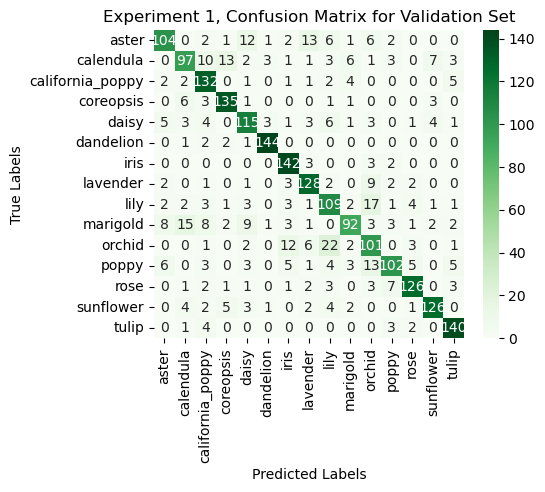

Eval Loss: 0.6815721570617623
Accuracy: 79.69%
Precision: 79.84, Recall: 79.69, F1 Score: 79.48
Validation completed.
----------------------------


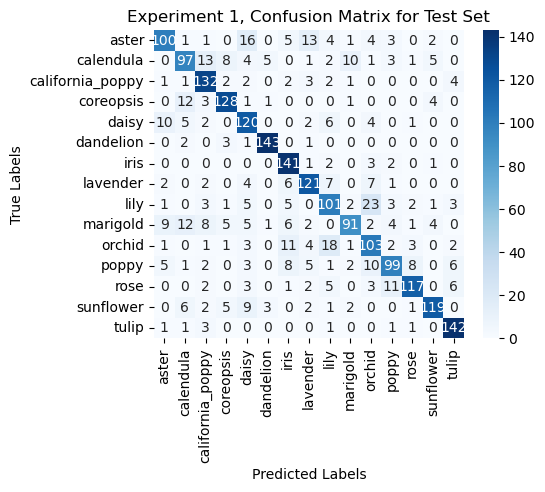

Eval Loss: 0.6999708844555749
Accuracy: 77.96%
Precision: 78.23, Recall: 77.96, F1 Score: 77.75
Test completed.
----------------------------
#######################################
 E X P E R I M E N T  1 E N D
#######################################
#######################################
 E X P E R I M E N T  2 S T A R T
#######################################
Experiment 2: Learning Rate (lr) = 0.001, Weight Decay (wd) = 0.01, Batch Size = 64
Epoch 1/5
Training Loss: 1.4407435503872958
Accuracy: 54.39%
Precision: 54.32, Recall: 54.39, F1 Score: 54.17
Epoch Time: 31.12 minutes
------------
Epoch 2/5
Training Loss: 0.7618776397271589
Accuracy: 76.47%
Precision: 76.41, Recall: 76.47, F1 Score: 76.35
Epoch Time: 31.03 minutes
------------
Epoch 3/5
Training Loss: 0.714586879087217
Accuracy: 77.75%
Precision: 77.70, Recall: 77.75, F1 Score: 77.66
Epoch Time: 31.02 minutes
------------
Epoch 4/5
Training Loss: 0.7024737441630075
Accuracy: 78.08%
Precision: 78.04, Recall: 78.08, F1 Score: 7

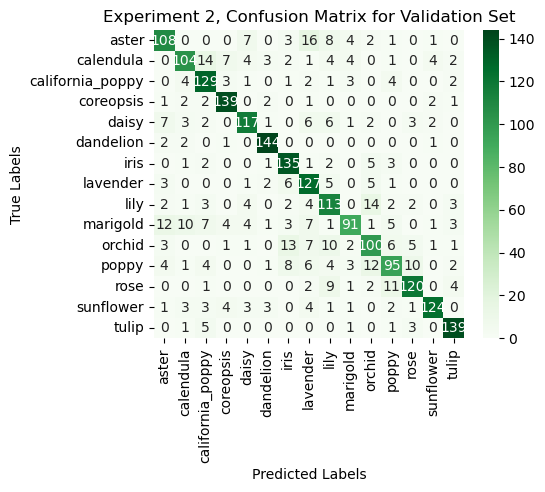

Eval Loss: 0.6959793973300192
Accuracy: 79.33%
Precision: 79.54, Recall: 79.33, F1 Score: 79.14
Validation completed.
----------------------------


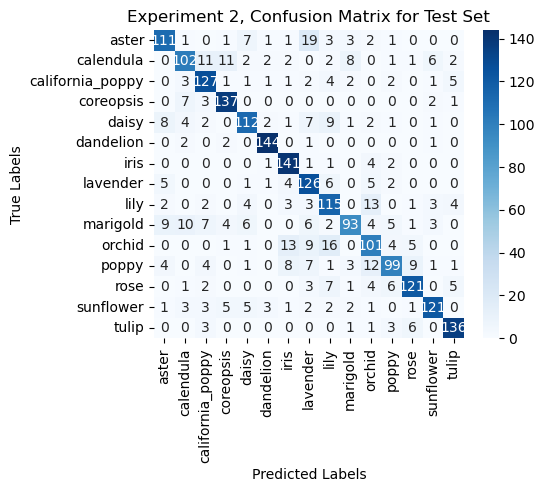

Eval Loss: 0.6889085900038481
Accuracy: 79.38%
Precision: 79.63, Recall: 79.38, F1 Score: 79.21
Test completed.
----------------------------
#######################################
 E X P E R I M E N T  2 E N D
#######################################
#######################################
 E X P E R I M E N T  3 S T A R T
#######################################
Experiment 3: Learning Rate (lr) = 0.01, Weight Decay (wd) = 0.001, Batch Size = 64
Epoch 1/5
Training Loss: 1.4707079114335957
Accuracy: 53.34%
Precision: 53.09, Recall: 53.34, F1 Score: 53.08
Epoch Time: 24.07 minutes
------------
Epoch 2/5
Training Loss: 0.7474788878903245
Accuracy: 76.94%
Precision: 77.09, Recall: 76.94, F1 Score: 76.96
Epoch Time: 23.86 minutes
------------
Epoch 3/5
Training Loss: 0.6165843682307186
Accuracy: 81.12%
Precision: 81.15, Recall: 81.12, F1 Score: 81.08
Epoch Time: 23.88 minutes
------------
Epoch 4/5
Training Loss: 0.6002315481503805
Accuracy: 81.62%
Precision: 81.70, Recall: 81.62, F1 Score: 

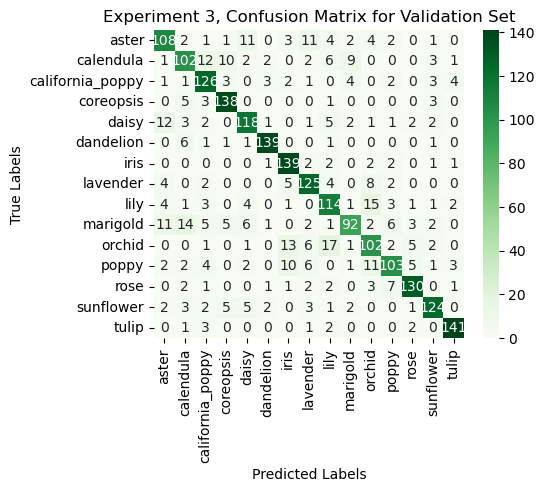

Eval Loss: 0.6583413121600946
Accuracy: 80.04%
Precision: 80.06, Recall: 80.04, F1 Score: 79.86
Validation completed.
----------------------------


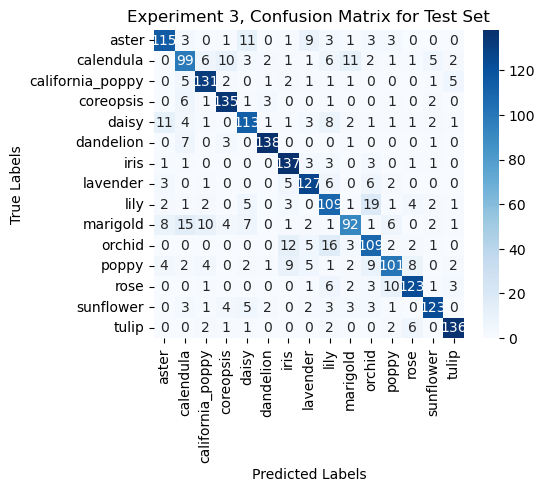

Eval Loss: 0.659613130821122
Accuracy: 79.47%
Precision: 79.55, Recall: 79.47, F1 Score: 79.35
Test completed.
----------------------------
#######################################
 E X P E R I M E N T  3 E N D
#######################################
#######################################
 E X P E R I M E N T  4 S T A R T
#######################################
Experiment 4: Learning Rate (lr) = 0.001, Weight Decay (wd) = 0.001, Batch Size = 64
Epoch 1/5
Training Loss: 1.42277492573767
Accuracy: 54.90%
Precision: 54.67, Recall: 54.90, F1 Score: 54.64
Epoch Time: 22.86 minutes
------------
Epoch 2/5
Training Loss: 0.7703790877804612
Accuracy: 76.12%
Precision: 76.07, Recall: 76.12, F1 Score: 76.02
Epoch Time: 23.03 minutes
------------
Epoch 3/5
Training Loss: 0.7325015230612322
Accuracy: 77.43%
Precision: 77.34, Recall: 77.43, F1 Score: 77.33
Epoch Time: 23.22 minutes
------------
Epoch 4/5
Training Loss: 0.713809677326318
Accuracy: 77.79%
Precision: 77.71, Recall: 77.79, F1 Score: 77.

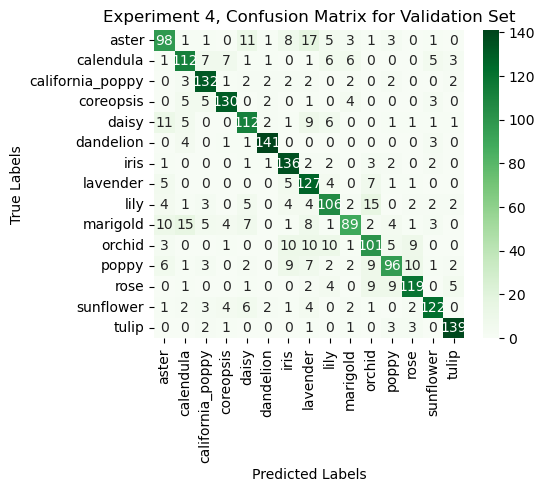

Eval Loss: 0.7081606085929606
Accuracy: 78.22%
Precision: 78.42, Recall: 78.22, F1 Score: 78.05
Validation completed.
----------------------------


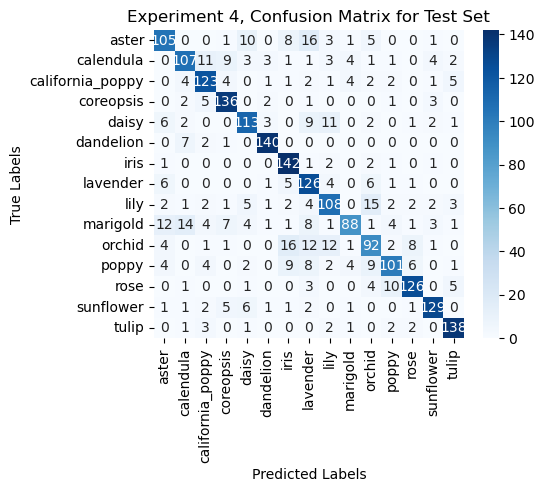

Eval Loss: 0.7000769929339489
Accuracy: 78.84%
Precision: 79.13, Recall: 78.84, F1 Score: 78.61
Test completed.
----------------------------
#######################################
 E X P E R I M E N T  4 E N D
#######################################
#######################################
 E X P E R I M E N T  5 S T A R T
#######################################
Experiment 5: Learning Rate (lr) = 0.001, Weight Decay (wd) = 0.001, Batch Size = 64
Epoch 1/5
Training Loss: 1.422248575181672
Accuracy: 54.68%
Precision: 54.39, Recall: 54.68, F1 Score: 54.33
Epoch Time: 34.21 minutes
------------
Epoch 2/5
Training Loss: 0.7577291679879029
Accuracy: 75.77%
Precision: 75.77, Recall: 75.77, F1 Score: 75.71
Epoch Time: 37.28 minutes
------------
Epoch 3/5
Training Loss: 0.7162113668340625
Accuracy: 77.54%
Precision: 77.66, Recall: 77.54, F1 Score: 77.55
Epoch Time: 36.45 minutes
------------
Epoch 4/5
Training Loss: 0.7123402665961872
Accuracy: 77.55%
Precision: 77.59, Recall: 77.55, F1 Score: 

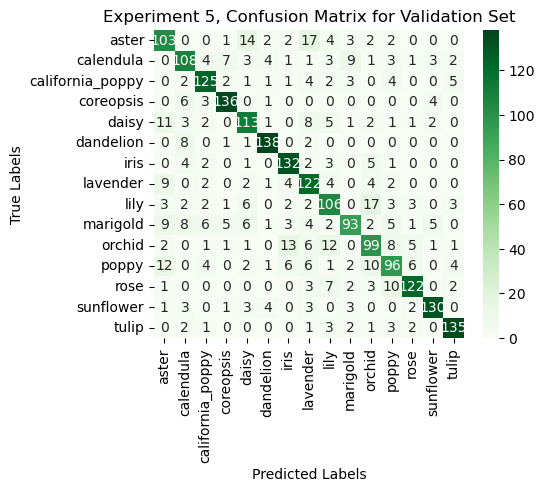

Eval Loss: 0.7088877289659448
Accuracy: 78.13%
Precision: 78.22, Recall: 78.13, F1 Score: 78.03
Validation completed.
----------------------------


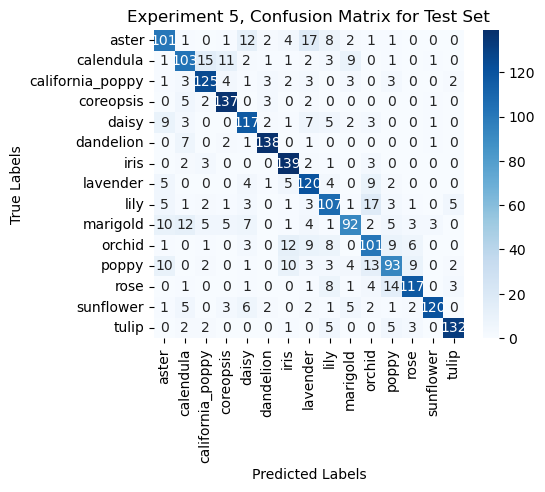

Eval Loss: 0.72252232208848
Accuracy: 77.42%
Precision: 77.66, Recall: 77.42, F1 Score: 77.33
Test completed.
----------------------------
#######################################
 E X P E R I M E N T  5 E N D
#######################################
#######################################
 E X P E R I M E N T  6 S T A R T
#######################################
Experiment 6: Learning Rate (lr) = 0.01, Weight Decay (wd) = 0.01, Batch Size = 32
Epoch 1/5
Training Loss: 1.8211525252887182
Accuracy: 40.49%
Precision: 39.68, Recall: 40.49, F1 Score: 39.86
Epoch Time: 25.77 minutes
------------
Epoch 2/5
Training Loss: 0.9886699335191025
Accuracy: 68.62%
Precision: 68.36, Recall: 68.62, F1 Score: 68.33
Epoch Time: 23.55 minutes
------------
Epoch 3/5
Training Loss: 0.8205697127932111
Accuracy: 74.36%
Precision: 74.37, Recall: 74.36, F1 Score: 74.23
Epoch Time: 23.11 minutes
------------
Epoch 4/5
Training Loss: 0.8014791397247634
Accuracy: 75.03%
Precision: 74.99, Recall: 75.03, F1 Score: 74.

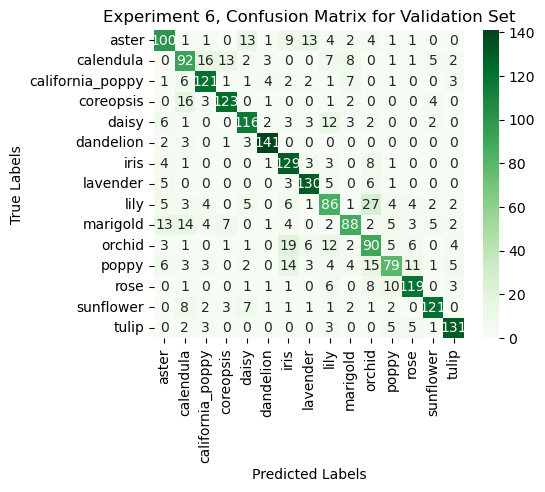

Eval Loss: 0.8453954015399369
Accuracy: 74.04%
Precision: 74.12, Recall: 74.04, F1 Score: 73.85
Validation completed.
----------------------------


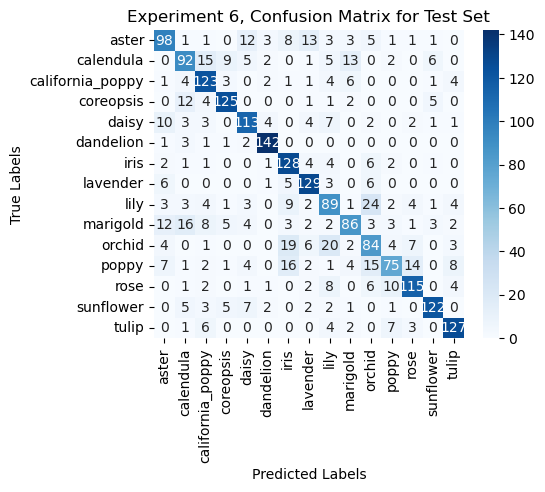

Eval Loss: 0.8586864640910021
Accuracy: 73.24%
Precision: 73.23, Recall: 73.24, F1 Score: 72.94
Test completed.
----------------------------
#######################################
 E X P E R I M E N T  6 E N D
#######################################


In [ ]:
# Train to all experiments

for exp in experiment_steps:
    print("#######################################")
    print(f" E X P E R I M E N T  {exp['idx']} S T A R T")
    print("#######################################")
    print(f"Experiment {exp['idx']}: Learning Rate (lr) = {exp['lr']}, Weight Decay (wd) = {exp['wd']}, Batch Size = {exp['bs']}")

    # Create data loaders
    train_loader = DataLoader(train_dataset, batch_size= exp["bs"], shuffle= True)
    valid_loader = DataLoader(valid_dataset, batch_size= exp["bs"], shuffle=False)
    test_loader = DataLoader(test_dataset, batch_size= exp["bs"], shuffle=False)

    # Train the model (also return and save) / comment if there is a model to load
    # Run the code for Task 1 (task2 = False)
    num_classes = len(train_dataset.classes)
    vgg_19, acc_train, prec_train, rec_train, f1_train, loss_train = train_vgg19(train_loader,
                                                                exp["lr"], exp["wd"], exp["idx"], num_classes, task2 = False)
    # Comment out if there is a model to load
    #vgg_19 = torch.load(fr'C:\Users\oguzh\Desktop\/vgg19_model{exp["idx"]}.pth')

    print('Training completed.')
    print("----------------------------")

    # Validate the model
    acc_val, prec_val, rec_val, f1_val, loss_val = eval_vgg19(vgg_19, valid_loader,
                                                    f'Experiment {exp["idx"]}, Confusion Matrix for Validation Set', 'Greens')
    print('Validation completed.')
    print("----------------------------")

    # Test the model
    acc_test, prec_test, rec_test, f1_test, loss_test = eval_vgg19(vgg_19, valid_loader,
                                                    f'Experiment {exp["idx"]}, Confusion Matrix for Test Set', 'Blues')
    print('Test completed.')
    print("----------------------------")

    # Data for the bar plot
    train_metrics = [acc_train, prec_train, rec_train, f1_train, loss_train]
    val_metrics = [acc_val, prec_val, rec_val, f1_val, loss_val]
    test_metrics = [acc_test, prec_test, rec_test, f1_test, loss_test]

    # Visualize experiment results
    print_metrics(metric_labels, train_metrics, val_metrics, test_metrics)

    print("#######################################")
    print(f" E X P E R I M E N T  {exp['idx']} E N D")
    print("#######################################")

### Results

As it stated in above too, experiment configurations are like this:

---

- idx: 1, lr: 0.01,  bs: 64, wd: 0.01     | First Experiment:   High Learning Rate,  64 Batch Size,  High Weight Decay

- idx: 2, lr: 0.001, bs: 64, wd: 0.01     | Second Experiment:  Low Learning Rate,   64 Batch Size,  High Weight Decay

- idx: 3, lr: 0.01,  bs: 64, wd: 0.001    | Third Experiment:   High Learning Rate,  64 Batch Size,  Low Weight Decay

- idx: 4, lr: 0.001, bs: 64, wd: 0.001    | Fourth Experiment:  Low Learning Rate,   64 Batch Size,  Low Weight Decay

- idx: 5, lr: 0.001, bs: 32, wd: 0.001    | Fifth Experiment:   Low Learning Rate,   32 Batch Size,  Low Weight Decay

- idx: 6, lr: 0.01,  bs: 32, wd: 0.01     | Sixth Experiment:   High Learning Rate,  32 Batch Size,  High Weight Decay

---

In terms of all types of **accuracies (train, validation and test)** , **the highest** value achieved at **Experiment 3**, which are **81.32%**, **80.04%** and **79.47%** in that order. Also Experiment 3 has **the highest precision, recall and f1-score values**. In loss results, Experiment 3 again has the **lowest loss**.
It is concluded that the most successful experiment in terms of performance is the **Experiment 3**.

Although the Experiment 3 had the highest values among the other experiments, most experiments seem to have obtained values close to the 3rd experiment.
Also, Experiment 2 steps up for having **2% less** training accuracy than test and validation accuracy. This is an interesting result because most of other experiments seem close to the overfitting, as they have higher training accuracy than validation and test.

We can order experiments by test accuracies like that:

**TEST ACCURACY**
- Experiment 3: 79.47%
- Experiment 2: 79.38%
- Experiment 4: 78.84%
- Experiment 1: 77.96%
- Experiment 5: 77.42%
- Experiment 6: 73.24%

**The worst** experiment seems like **Experiment 6**, with about **6%** lower performance values. Considering the experiment conditions, we reach the following results:

- Experiments with **"Batch Size" = 64** are generally more successfull than **"Batch Size" = 32**.
- When **Top 3** experiments considered as **successful**, it is concluded that **High Learning Rate and High Weight Decay** doesn't work well together **(Experiment 1 and 6)**.
- It seems opposite situations of **lr** and **wd** has the most successful result **(Experiment 2 and 3)**.

---

When the confusion matrices are examined, the situations in which the most and least successful results are obtained in terms of flower categories are as follows (flower category - number of true positive classified flower images - experiment number - evaluation type | same for least):

- **Aster**: 115 - Exp3 Test | 98 - Exp4 Val, Exp6 Test
- **Calendula**: 112 - Exp4 Val | 92 - Exp6 Val, Test
- **California Poppy**: 132 - Exp1 Val, Test, Exp4 Val | 121 - Exp6 Val
- **Coreopsis**: 139 - Exp2 Val | 123 - Exp6 Val
- **Daisy**: 120 - Exp1 Test | 112 - Exp4 Val
- **Dandelion**: 144 - Exp1 Val, Exp2 Val, Test | 138 Exp3 Test, Exp5 Val, Test
- **Iris**: 142 - Exp1 Val, Exp4 Test | 128 - Exp6 Test
- **Lavender**: 130 - Exp6 Val | 120 - Exp5 Test
- **Lily**: 115 - Exp2 Test | 86 - Exp6 Validation
- **Marigold**: 93 - Exp2 Test, Exp5 Val | 86 - Exp6 Test
- **Orchid**: 103 - Exp1 Test | 84 - Exp6 Test
- **Poppy** : 103 - Exp3 Val | 75 - Exp6 Test
- **Rose**: 130 - Exp3 Val | 115 - Exp6 Test
- **Sunflower**: 130 - Exp5 Val | 119 - Exp1 Test
- **Tulip**: 142 - Exp1 Test | 127 - Exp6 Test

When these results are examined, it is possible to see that there is some accumulation due to the dataset. For example, all of the experiments in species such as **California Poppy, Coreopsis, Dandelion, Iris, Lavender, Rose, Sunflower and Tulip** achieved **above-average** results. Likewise, in species such as **Marigold, Orchid and Poppy**, all of the experiments seem to have achieved **below-average** results.

But it can be seem that there are serious gaps in some flower types and this is where the differences in accuracy arise. For example, in the **Lily**, **the best result** was obtained by **Exp2 Test** with **115 TP**, while **the worst** result, **Exp6 Val**, could only obtain **86 TP**. Likewise, it is possible to see this difference in flower types such as **Orchid and Poppy**. These appear to be the **inter-experimental determinants** of flower types.

## Visualization of Task 1

#######################################
 E X P E R I M E N T  1 S T A R T
#######################################
Experiment 1: Learning Rate (lr) = 0.01, Weight Decay (wd) = 0.01, Batch Size = 64
16


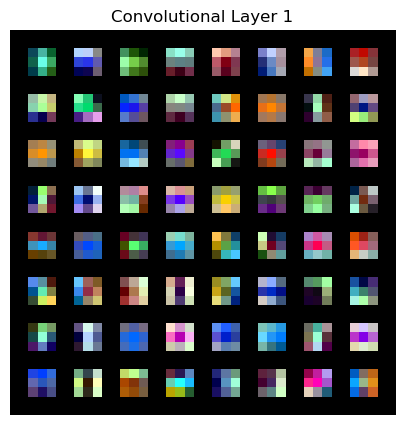

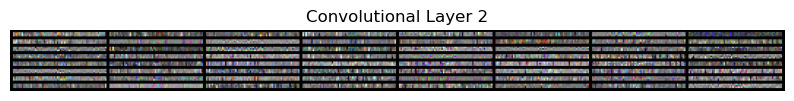

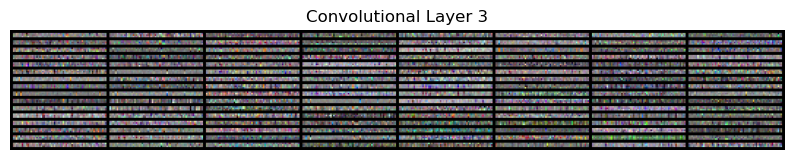

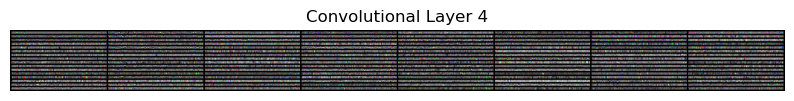

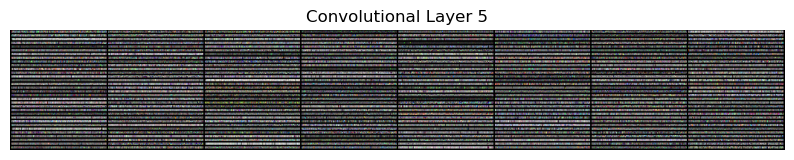

...

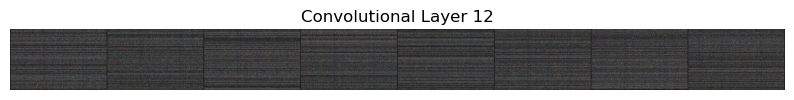

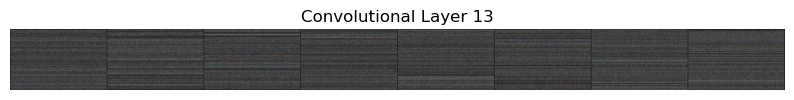

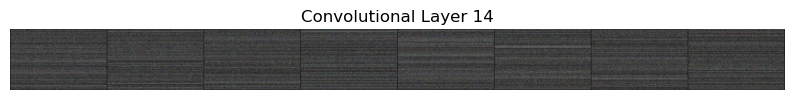

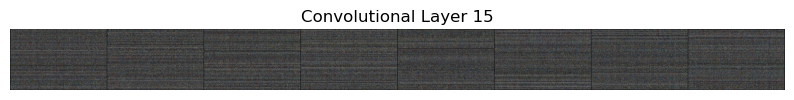

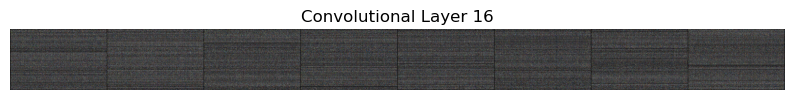

#######################################
 E X P E R I M E N T  1 E N D
#######################################
#######################################
 E X P E R I M E N T  2 S T A R T
#######################################
Experiment 2: Learning Rate (lr) = 0.001, Weight Decay (wd) = 0.01, Batch Size = 64
16


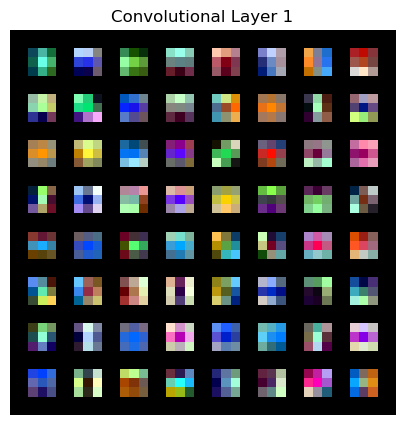

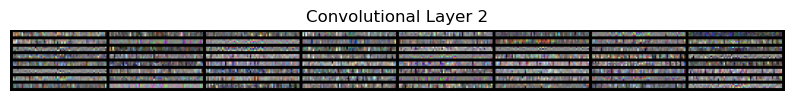

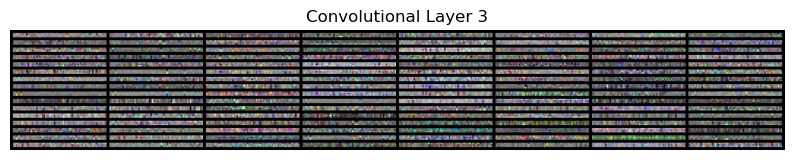

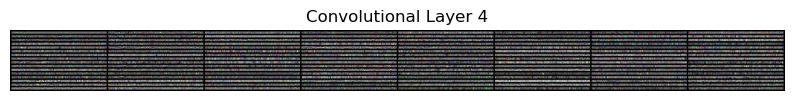

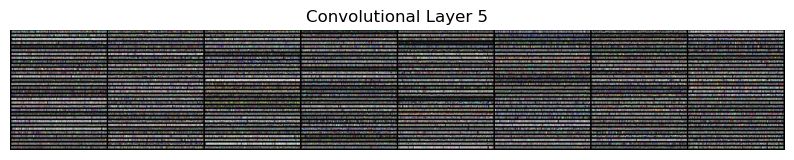

...

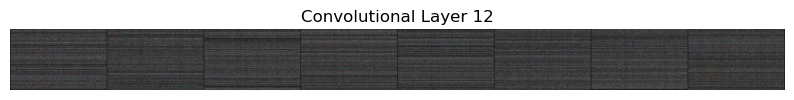

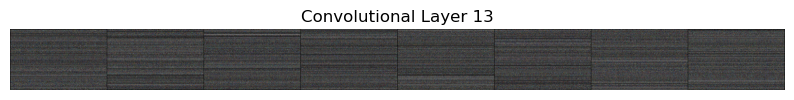

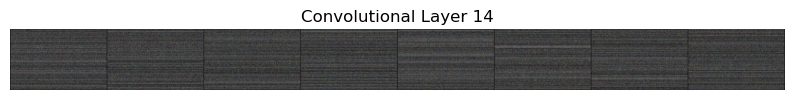

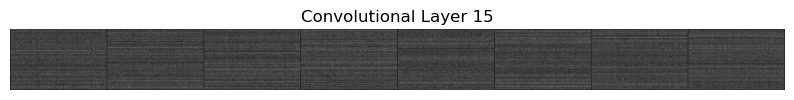

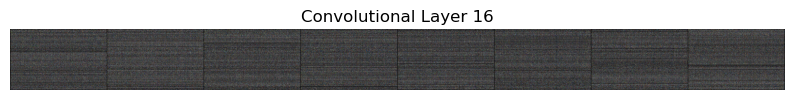

#######################################
 E X P E R I M E N T  2 E N D
#######################################
#######################################
 E X P E R I M E N T  3 S T A R T
#######################################
Experiment 3: Learning Rate (lr) = 0.01, Weight Decay (wd) = 0.001, Batch Size = 64
16


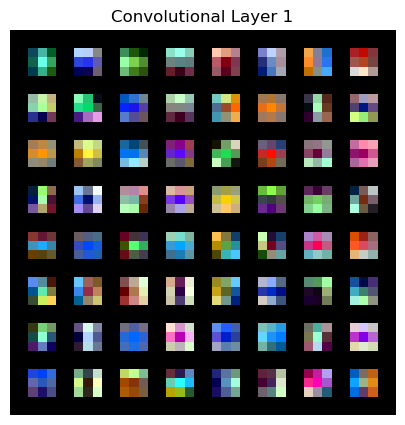

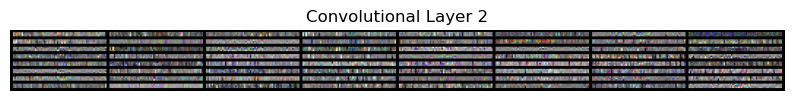

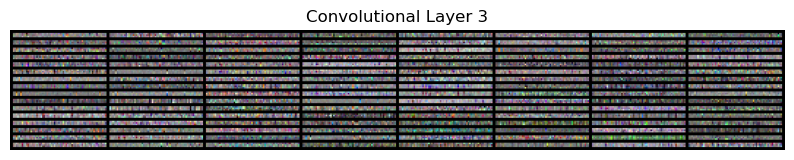

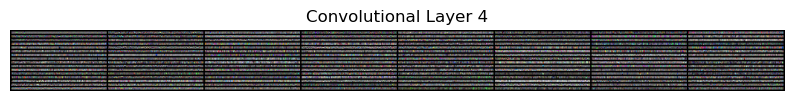

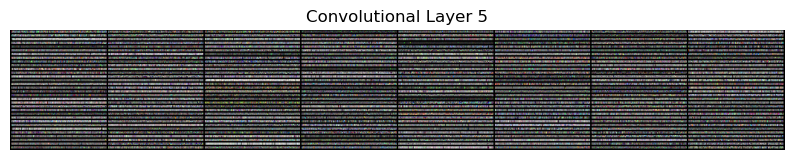

...

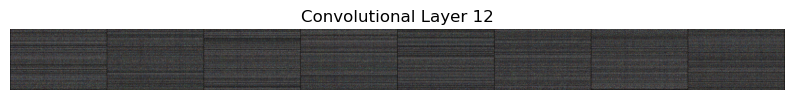

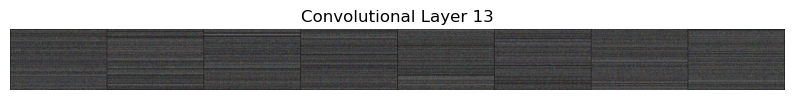

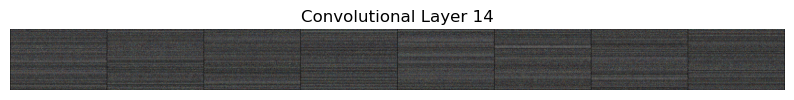

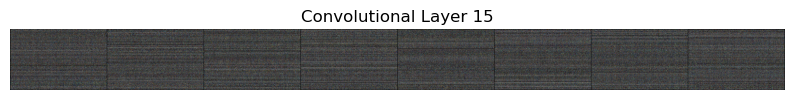

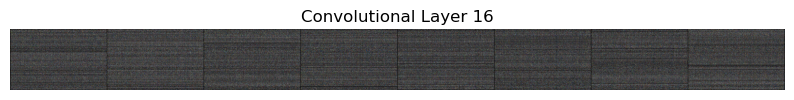

#######################################
 E X P E R I M E N T  3 E N D
#######################################
#######################################
 E X P E R I M E N T  4 S T A R T
#######################################
Experiment 4: Learning Rate (lr) = 0.001, Weight Decay (wd) = 0.001, Batch Size = 64
16


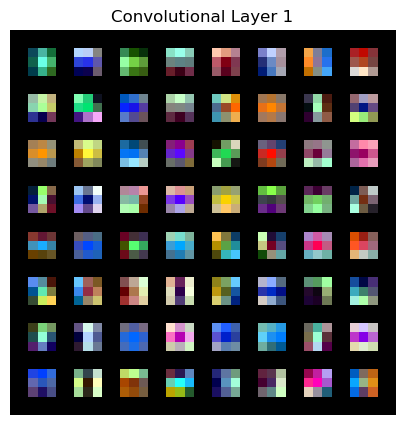

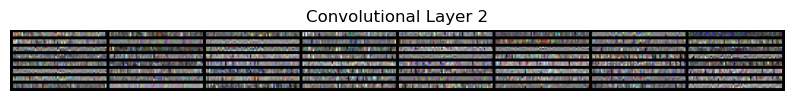

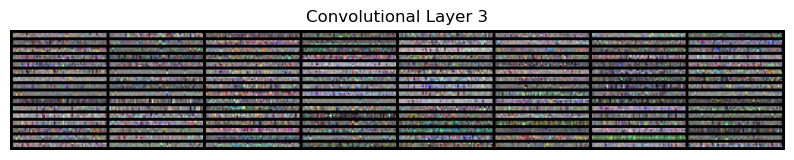

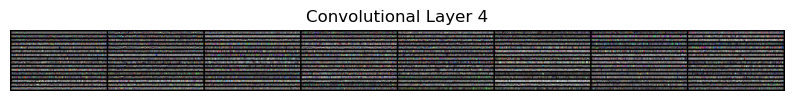

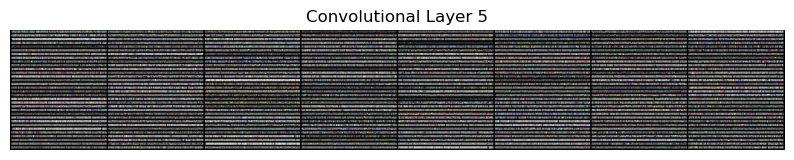

...

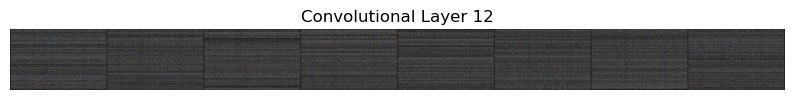

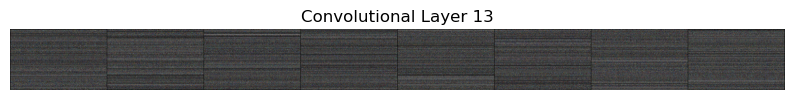

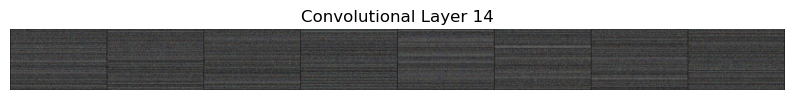

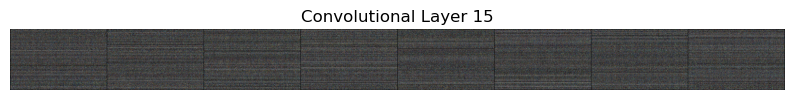

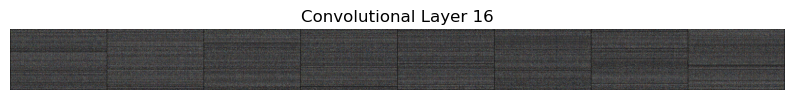

#######################################
 E X P E R I M E N T  4 E N D
#######################################
#######################################
 E X P E R I M E N T  5 S T A R T
#######################################
Experiment 5: Learning Rate (lr) = 0.001, Weight Decay (wd) = 0.001, Batch Size = 64
16


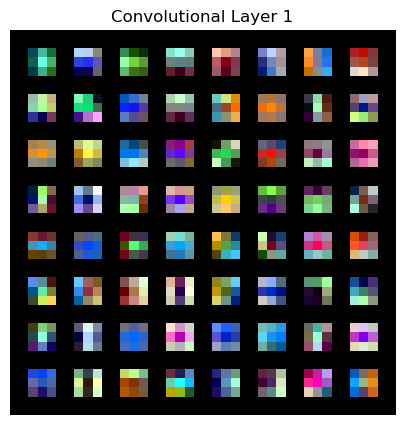

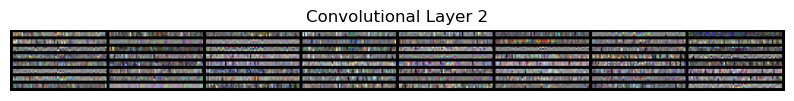

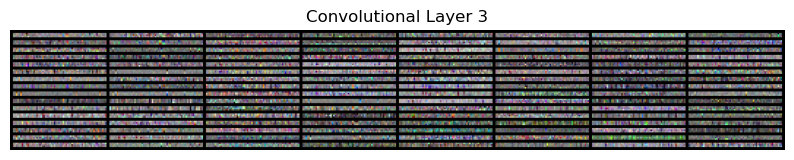

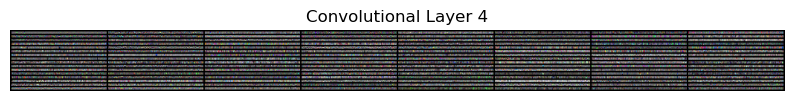

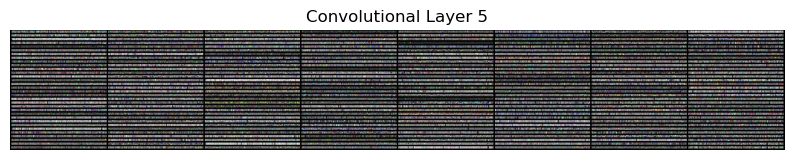

...

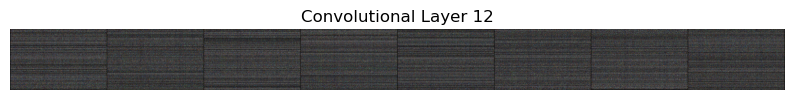

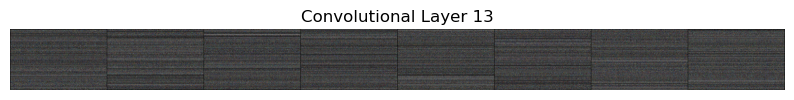

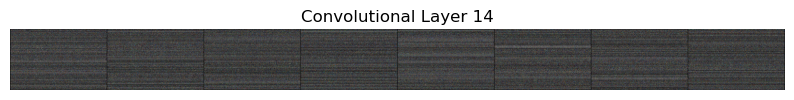

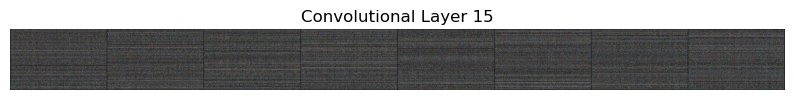

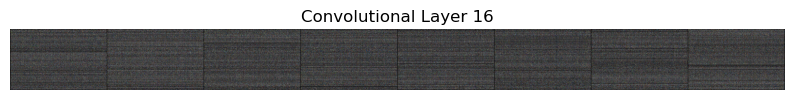

#######################################
 E X P E R I M E N T  5 E N D
#######################################
#######################################
 E X P E R I M E N T  6 S T A R T
#######################################
Experiment 6: Learning Rate (lr) = 0.01, Weight Decay (wd) = 0.01, Batch Size = 32
16


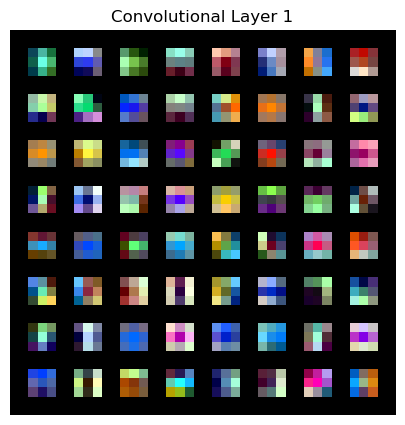

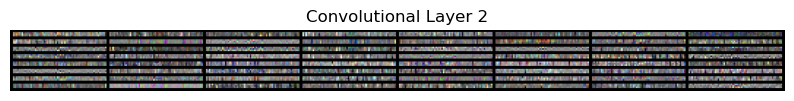

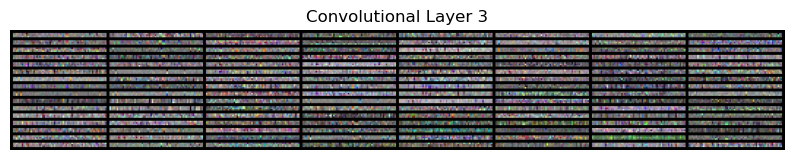

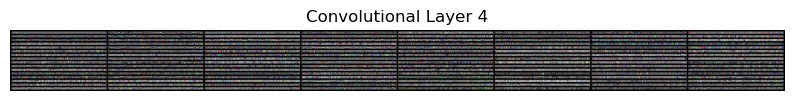

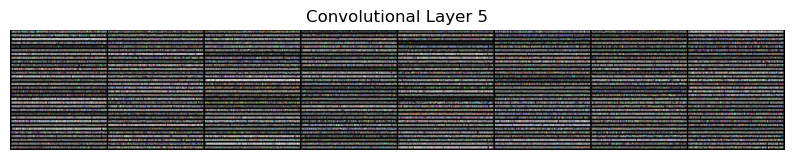

...

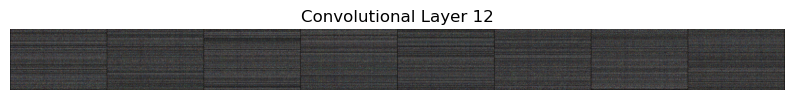

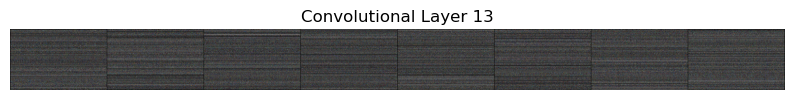

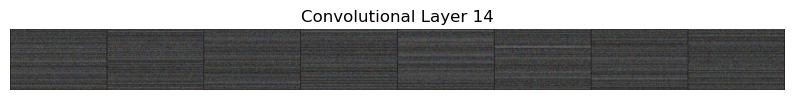

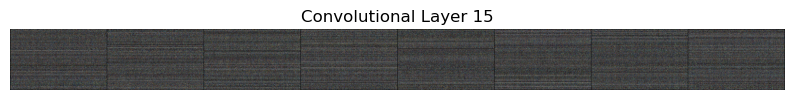

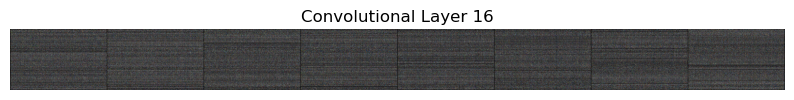

#######################################
 E X P E R I M E N T  6 E N D
#######################################


In [ ]:
for exp in experiment_steps:
    print("#######################################")
    print(f" E X P E R I M E N T  {exp['idx']} S T A R T")
    print("#######################################")
    print(f"Experiment {exp['idx']}: Learning Rate (lr) = {exp['lr']}, Weight Decay (wd) = {exp['wd']}, Batch Size = {exp['bs']}")

    vgg_19 = torch.load(fr'C:\Users\oguzh\Desktop\/vgg19_model{exp["idx"]}.pth')

    conv_layers = [layer for layer in vgg_19.features if isinstance(layer, torch.nn.Conv2d)]

    print(len(conv_layers))

    # Iterate through convolutional layers
    for i, layer in enumerate(conv_layers):
        # Get the weights of the layer
        filters = layer.weight.data

        # Normalize and reshape filters for visualization
        filters = filters - filters.min()
        filters = filters / filters.max()

        # Move the tensor to the CPU before calling numpy()
        filters_cpu = filters.cpu().detach().numpy()

        # Reshape the filters to have a valid shape for visualization
        filters_reshaped = filters_cpu.transpose(0, 2, 3, 1)

        # Create a grid of filter images
        grid = torchvision.utils.make_grid(torch.from_numpy(filters_reshaped), nrow=8, normalize=True, scale_each=True)

        # Convert the grid to a NumPy array
        grid_np = grid.permute(1, 2, 0).numpy()

        # Plot the grid
        plt.figure(figsize=(10, 5))
        plt.imshow(grid_np)
        plt.title(f'Convolutional Layer {i+1}')
        plt.axis('off')
        plt.show()

    print("#######################################")
    print(f" E X P E R I M E N T  {exp['idx']} E N D")
    print("#######################################")

## Finetune of FC1 and FC2 layers

Although the code is pretty much the same as in task 1, it was decided to separate this for the sake of simplicity in terms of output.

#######################################
 E X P E R I M E N T  7 S T A R T
#######################################
Experiment 7: Learning Rate (lr) = 0.01, Weight Decay (wd) = 0.01, Batch Size = 64
Epoch 1/5
Training Loss: 1075301.2523083817
Accuracy: 19.33%
Precision: 20.24, Recall: 19.33, F1 Score: 19.66
Epoch Time: 3.29 minutes
------------
Epoch 2/5
Training Loss: 2298494.90625
Accuracy: 44.78%
Precision: 44.61, Recall: 44.78, F1 Score: 44.69
Epoch Time: 3.01 minutes
------------
Epoch 3/5
Training Loss: 564086.2651515151
Accuracy: 54.09%
Precision: 54.23, Recall: 54.09, F1 Score: 54.13
Epoch Time: 3.01 minutes
------------
Epoch 4/5
Training Loss: 515399.8259469697
Accuracy: 54.77%
Precision: 54.86, Recall: 54.77, F1 Score: 54.78
Epoch Time: 3.01 minutes
------------
Epoch 5/5
Training Loss: 498119.8259469697
Accuracy: 55.66%
Precision: 55.62, Recall: 55.66, F1 Score: 55.62
Epoch Time: 3.01 minutes
------------
Train Time: 15.37 minutes
Train 7 complete.
---------------------------

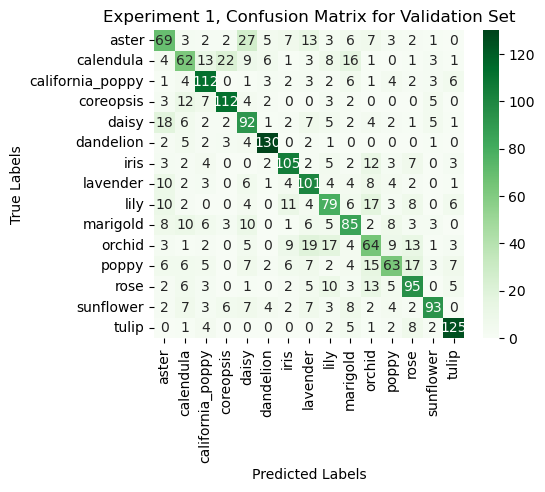

Eval Loss: 360010.71180555556
Accuracy: 61.64%
Precision: 61.61, Recall: 61.64, F1 Score: 61.39
Validation completed.
----------------------------


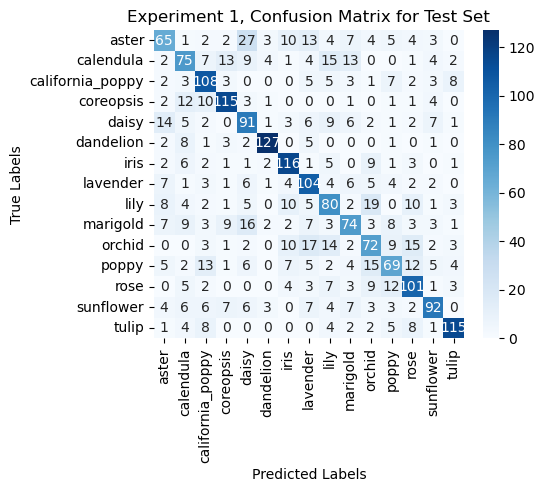

Eval Loss: 349071.3376736111
Accuracy: 62.40%
Precision: 62.45, Recall: 62.40, F1 Score: 62.20
Test completed.
----------------------------


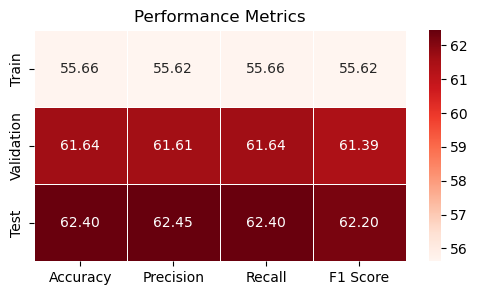

#######################################
 E X P E R I M E N T  7 E N D
#######################################
#######################################
 E X P E R I M E N T  8 S T A R T
#######################################
Experiment 8: Learning Rate (lr) = 0.001, Weight Decay (wd) = 0.01, Batch Size = 64
Epoch 1/5
Training Loss: 1.6625752571857337
Accuracy: 47.61%
Precision: 47.44, Recall: 47.61, F1 Score: 47.41
Epoch Time: 3.00 minutes
------------
Epoch 2/5
Training Loss: 1.3066969232125716
Accuracy: 58.77%
Precision: 58.65, Recall: 58.77, F1 Score: 58.57
Epoch Time: 3.00 minutes
------------
Epoch 3/5
Training Loss: 1.2753720778407474
Accuracy: 60.74%
Precision: 60.78, Recall: 60.74, F1 Score: 60.66
Epoch Time: 3.01 minutes
------------
Epoch 4/5
Training Loss: 1.2873585061593489
Accuracy: 59.88%
Precision: 59.92, Recall: 59.88, F1 Score: 59.81
Epoch Time: 3.01 minutes
------------
Epoch 5/5
Training Loss: 1.2799012408112034
Accuracy: 59.95%
Precision: 59.95, Recall: 59.95, F1 Sco

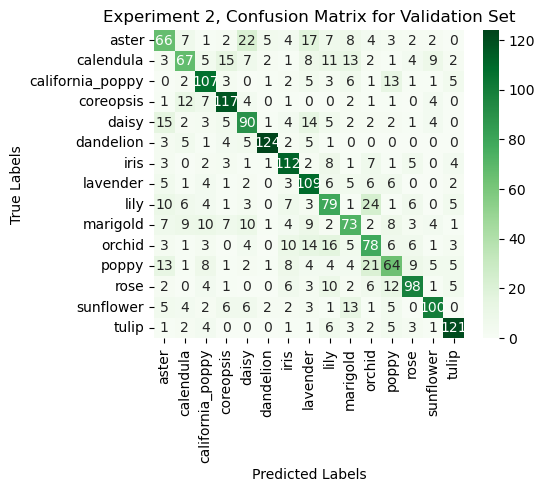

Eval Loss: 1.2020807100666895
Accuracy: 62.44%
Precision: 62.52, Recall: 62.44, F1 Score: 62.25
Validation completed.
----------------------------


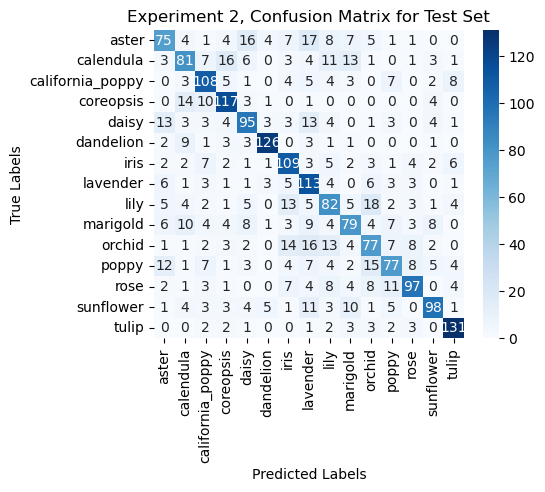

Eval Loss: 1.162874227596654
Accuracy: 65.11%
Precision: 65.35, Recall: 65.11, F1 Score: 64.93
Test completed.
----------------------------


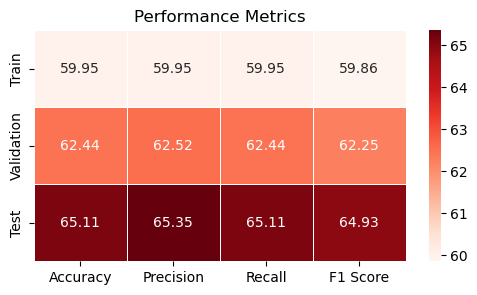

#######################################
 E X P E R I M E N T  8 E N D
#######################################
#######################################
 E X P E R I M E N T  9 S T A R T
#######################################
Experiment 9: Learning Rate (lr) = 0.01, Weight Decay (wd) = 0.001, Batch Size = 64
Epoch 1/5
Training Loss: 1580393.525098659
Accuracy: 19.95%
Precision: 20.53, Recall: 19.95, F1 Score: 20.16
Epoch Time: 4.52 minutes
------------
Epoch 2/5
Training Loss: 5269558.973484849
Accuracy: 43.73%
Precision: 43.61, Recall: 43.73, F1 Score: 43.65
Epoch Time: 5.99 minutes
------------
Epoch 3/5
Training Loss: 1126179.1231060605
Accuracy: 54.45%
Precision: 54.36, Recall: 54.45, F1 Score: 54.38
Epoch Time: 5.95 minutes
------------
Epoch 4/5
Training Loss: 972308.2306818182
Accuracy: 56.52%
Precision: 56.33, Recall: 56.52, F1 Score: 56.39
Epoch Time: 5.91 minutes
------------
Epoch 5/5
Training Loss: 948735.2532196969
Accuracy: 56.43%
Precision: 56.28, Recall: 56.43, F1 Score: 

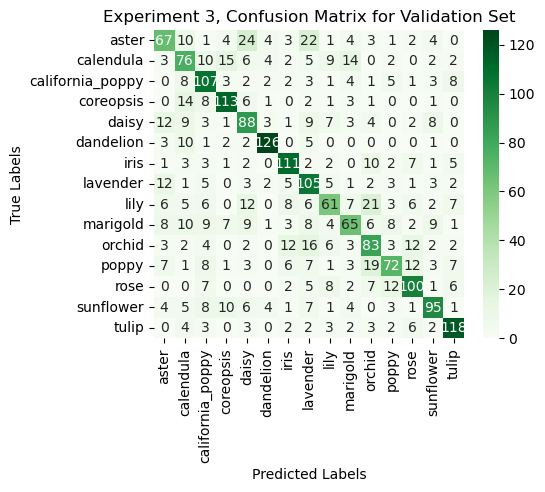

Eval Loss: 719609.7178819445
Accuracy: 61.64%
Precision: 61.79, Recall: 61.64, F1 Score: 61.32
Validation completed.
----------------------------


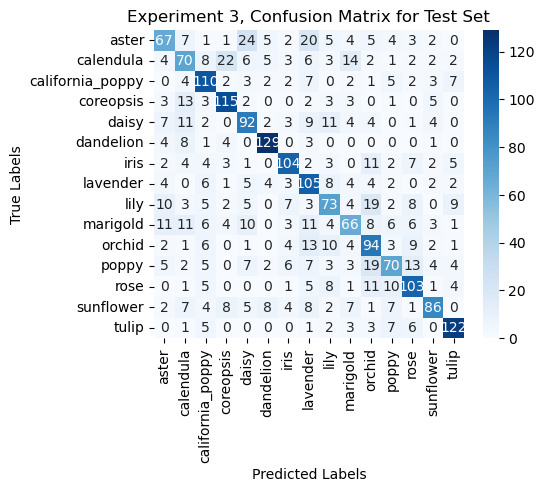

Eval Loss: 710378.1471354166
Accuracy: 62.49%
Precision: 62.59, Recall: 62.49, F1 Score: 62.17
Test completed.
----------------------------


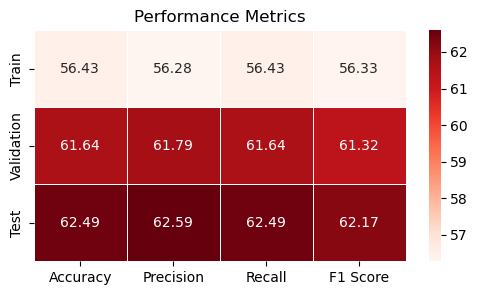

#######################################
 E X P E R I M E N T  9 E N D
#######################################
#######################################
 E X P E R I M E N T  10 S T A R T
#######################################
Experiment 10: Learning Rate (lr) = 0.001, Weight Decay (wd) = 0.001, Batch Size = 64
Epoch 1/5
Training Loss: 1.654814533031348
Accuracy: 47.53%
Precision: 47.62, Recall: 47.53, F1 Score: 47.41
Epoch Time: 5.97 minutes
------------
Epoch 2/5
Training Loss: 1.305247922377153
Accuracy: 60.08%
Precision: 59.93, Recall: 60.08, F1 Score: 59.90
Epoch Time: 5.90 minutes
------------
Epoch 3/5
Training Loss: 1.2766417915170842
Accuracy: 60.01%
Precision: 59.83, Recall: 60.01, F1 Score: 59.76
Epoch Time: 5.84 minutes
------------
Epoch 4/5
Training Loss: 1.2962403839284724
Accuracy: 59.30%
Precision: 59.09, Recall: 59.30, F1 Score: 59.02
Epoch Time: 5.82 minutes
------------
Epoch 5/5
Training Loss: 1.2740763736493659
Accuracy: 60.17%
Precision: 60.03, Recall: 60.17, F1 Sc

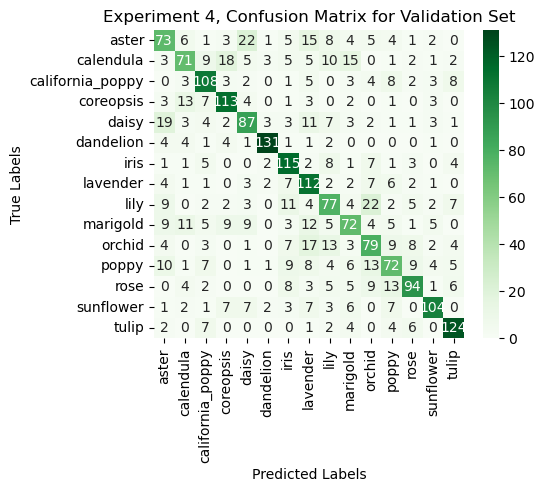

Eval Loss: 1.1822315595216222
Accuracy: 63.64%
Precision: 63.72, Recall: 63.64, F1 Score: 63.40
Validation completed.
----------------------------


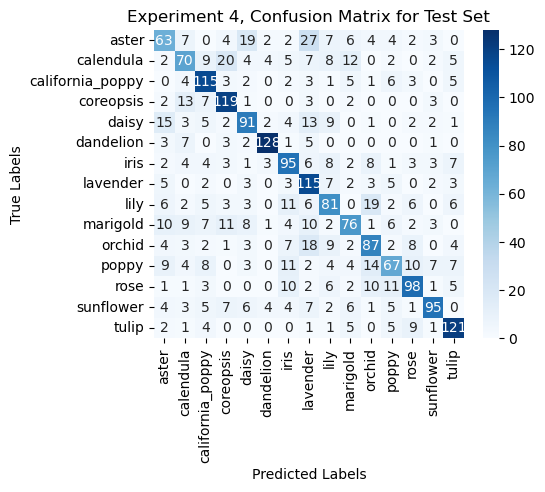

Eval Loss: 1.2036319052179654
Accuracy: 63.16%
Precision: 63.34, Recall: 63.16, F1 Score: 62.83
Test completed.
----------------------------


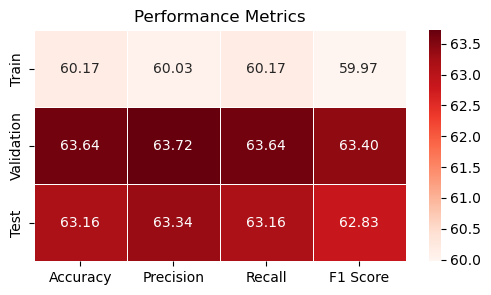

#######################################
 E X P E R I M E N T  10 E N D
#######################################
#######################################
 E X P E R I M E N T  11 S T A R T
#######################################
Experiment 11: Learning Rate (lr) = 0.001, Weight Decay (wd) = 0.001, Batch Size = 32
Epoch 1/5
Training Loss: 1.61784746835297
Accuracy: 49.11%
Precision: 48.93, Recall: 49.11, F1 Score: 48.95
Epoch Time: 2.94 minutes
------------
Epoch 2/5
Training Loss: 1.2741515009598892
Accuracy: 60.42%
Precision: 60.16, Recall: 60.42, F1 Score: 60.17
Epoch Time: 2.93 minutes
------------
Epoch 3/5
Training Loss: 1.2449299749270035
Accuracy: 60.96%
Precision: 60.65, Recall: 60.96, F1 Score: 60.66
Epoch Time: 2.93 minutes
------------
Epoch 4/5
Training Loss: 1.2349296679612713
Accuracy: 61.26%
Precision: 61.16, Recall: 61.26, F1 Score: 61.06
Epoch Time: 2.93 minutes
------------
Epoch 5/5
Training Loss: 1.2294099233070768
Accuracy: 61.78%
Precision: 61.58, Recall: 61.78, F1 S

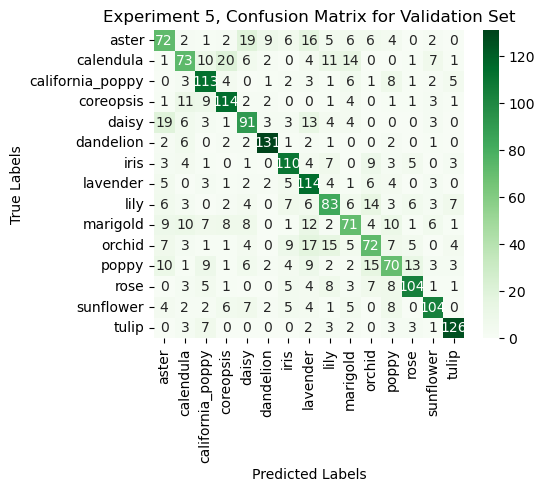

Eval Loss: 1.1350990147657798
Accuracy: 64.36%
Precision: 64.21, Recall: 64.36, F1 Score: 64.05
Validation completed.
----------------------------


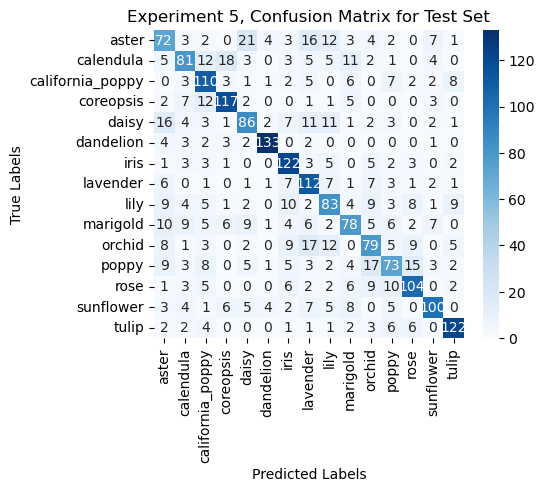

Eval Loss: 1.1340485307532298
Accuracy: 65.42%
Precision: 65.41, Recall: 65.42, F1 Score: 65.18
Test completed.
----------------------------


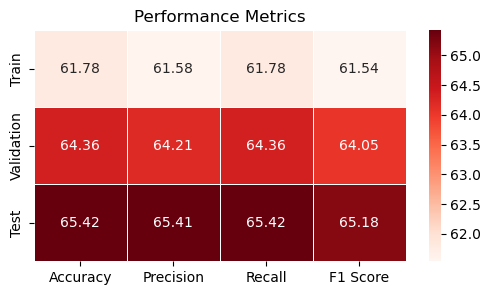

#######################################
 E X P E R I M E N T  11 E N D
#######################################
#######################################
 E X P E R I M E N T  12 S T A R T
#######################################
Experiment 12: Learning Rate (lr) = 0.01, Weight Decay (wd) = 0.01, Batch Size = 32
Epoch 1/5
Training Loss: 3.552043412965133e+20
Accuracy: 12.62%
Precision: 13.04, Recall: 12.62, F1 Score: 12.77
Epoch Time: 2.95 minutes
------------
Epoch 2/5
Training Loss: 1.688255681560173e+21
Accuracy: 42.50%
Precision: 42.30, Recall: 42.50, F1 Score: 42.39
Epoch Time: 2.94 minutes
------------
Epoch 3/5
Training Loss: 4.29856901376207e+20
Accuracy: 55.36%
Precision: 55.15, Recall: 55.36, F1 Score: 55.24
Epoch Time: 2.94 minutes
------------
Epoch 4/5
Training Loss: 3.531246753285435e+20
Accuracy: 57.09%
Precision: 57.12, Recall: 57.09, F1 Score: 57.09
Epoch Time: 2.94 minutes
------------
Epoch 5/5
Training Loss: 3.4610908475557046e+20
Accuracy: 57.30%
Precision: 57.22, Reca

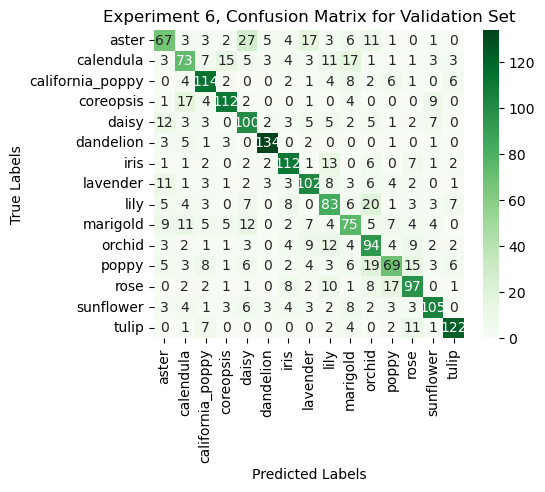

Eval Loss: 2.3228246107443144e+20
Accuracy: 64.84%
Precision: 64.82, Recall: 64.84, F1 Score: 64.66
Validation completed.
----------------------------


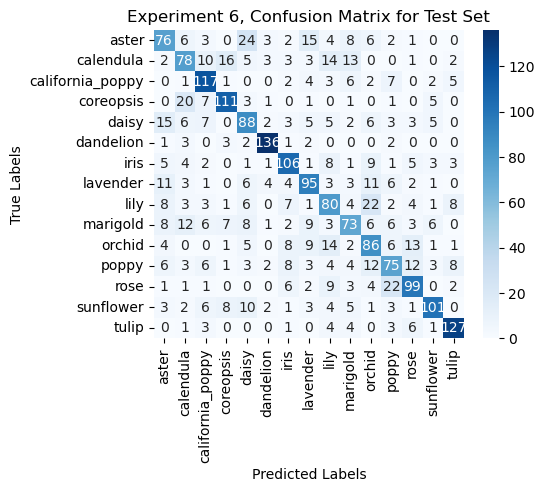

Eval Loss: 2.3305215498671774e+20
Accuracy: 64.36%
Precision: 64.31, Recall: 64.36, F1 Score: 64.23
Test completed.
----------------------------


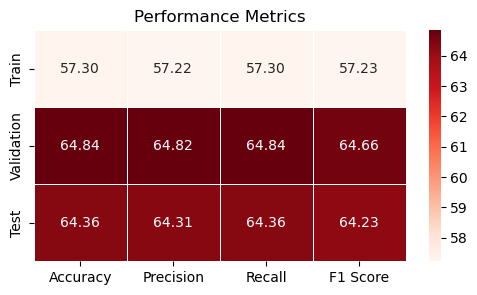

#######################################
 E X P E R I M E N T  12 E N D
#######################################


In [ ]:
# Train to all experiments

for exp in experiment_steps:
    print("#######################################")
    print(f" E X P E R I M E N T  {exp['idx'] + 6} S T A R T")
    print("#######################################")
    print(f"Experiment {exp['idx'] + 6}: Learning Rate (lr) = {exp['lr']}, Weight Decay (wd) = {exp['wd']}, Batch Size = {exp['bs']}")

    # Create data loaders
    train_loader = DataLoader(train_dataset, batch_size= exp["bs"], shuffle= True)
    valid_loader = DataLoader(valid_dataset, batch_size= exp["bs"], shuffle=False)
    test_loader = DataLoader(test_dataset, batch_size= exp["bs"], shuffle=False)

    # Train the model (also return and save) / comment if there is a model to load
    # Run the code for Task 2 (task2 = True)
    num_classes = len(train_dataset.classes)
    vgg_19, acc_train, prec_train, rec_train, f1_train, loss_train = train_vgg19(train_loader,
                                                                exp["lr"], exp["wd"], exp["idx"] + 6, num_classes, task2= True)
    # Comment out if there is a model to load
    #vgg_19 = torch.load(fr'C:\Users\oguzh\Desktop\/vgg19_model{exp["idx"] + 6}.pth')

    print('Training completed.')
    print("----------------------------")

    # Validate the model
    acc_val, prec_val, rec_val, f1_val, loss_val = eval_vgg19(vgg_19, valid_loader,
                                                    f'Experiment {exp["idx"] + 6}, Confusion Matrix for Validation Set', 'Greens')
    print('Validation completed.')
    print("----------------------------")

    # Test the model
    acc_test, prec_test, rec_test, f1_test, loss_test = eval_vgg19(vgg_19, valid_loader,
                                                    f'Experiment {exp["idx"] + 6}, Confusion Matrix for Test Set', 'Blues')
    print('Test completed.')
    print("----------------------------")

    # Data for the bar plot
    train_metrics = [acc_train, prec_train, rec_train, f1_train]
    val_metrics = [acc_val, prec_val, rec_val, f1_val]
    test_metrics = [acc_test, prec_test, rec_test, f1_test]

    # Visualize experiment results
    print_metrics(metric_labels, train_metrics, val_metrics, test_metrics)

    print("#######################################")
    print(f" E X P E R I M E N T  {exp['idx'] + 6} E N D")
    print("#######################################")

### Results

As it stated in above too, experiment configurations are like this:

---

- idx: 7, lr: 0.01,  bs: 64, wd: 0.01     | First Experiment:   High Learning Rate,  64 Batch Size,  High Weight Decay

- idx: 8, lr: 0.001, bs: 64, wd: 0.01     | Second Experiment:  Low Learning Rate,   64 Batch Size,  High Weight Decay

- idx: 9, lr: 0.01,  bs: 64, wd: 0.001    | Third Experiment:   High Learning Rate,  64 Batch Size,  Low Weight Decay

- idx: 10, lr: 0.001, bs: 64, wd: 0.001    | Fourth Experiment:  Low Learning Rate,   64 Batch Size,  Low Weight Decay

- idx: 11, lr: 0.001, bs: 32, wd: 0.001    | Fifth Experiment:   Low Learning Rate,   32 Batch Size,  Low Weight Decay

- idx: 12, lr: 0.01,  bs: 32, wd: 0.01     | Sixth Experiment:   High Learning Rate,  32 Batch Size,  High Weight Decay

---

In terms of **train and test accuracies, the highest** value achieved at **Experiment 11**, which are **61.78%** and **65.42%**. But **the highest validation accuracy** comes from **Experiment 12** with **64.84%** .Also Experiment 11 has **the highest precision, recall and f1-score values**. In loss results, Experiment 11 again has the **lowest loss**.
It is concluded that the most successful experiment in terms of performance is the **Experiment 11**.

Although the Experiment 11 had the highest values among the other experiments, Experiment 8 seem to have obtained values close to the 11th experiment.
All experiments has **more validation and test accuracies** than **training accuracy**. This could be related with freezing other layers and fine tuning only two fully connected layers.
In the **7th and 9th experiments**, **unbelievably high loss values** are observed. The underlying reason for this phenomenon remains **unclear**.

Additionally, these six experiments have **lower accuracy, precision, recall, and F1-score** values, and **much higher loss** values compared to the first six experiments, where the entire model is fine-tuned. However, along with this, the execution time is also significantly accelerated.

We can order experiments by test accuracies like that:

**TEST ACCURACY**
- Experiment 11: 65.42%
- Experiment 8: 65.11%
- Experiment 12: 64.36%
- Experiment 10: 63.16%
- Experiment 9: 62.49%
- Experiment 7: 62.40%

**The worst** experiment seems like **Experiment 7**, with about **3%** lower performance values. Considering the experiment conditions, we reach the following results:

- Experiments with **"Batch Size" = 32** are generally more successfull than **"Batch Size" = 64**.
- When **Top 3** experiments considered as **successful**, it is concluded that both **High-High or Low-Low Learning Rate and Weight Decay** does work well together **(Experiment 11 and 12)**.
- It seems in these six experiments, changes in hyperparameters yielded different results. For example, bs 64 was optimal for first six experiments, but bs 32 is optimal for this six experiments.
- Additionally, in first six experiments, **the last two** experiments were yielding **the worst** results, now **the last two** experiments are producing **the best** outcomes.

---

When the confusion matrices are examined, the situations in which the most and least successful results are obtained in terms of flower categories are as follows (flower category - number of true positive classified flower images - experiment number - evaluation type | same for least):

- **Aster**: 76 - Exp12 Test | 63 - Exp10 Test
- **Calendula**: 81 - Exp8 Test, Exp11 Test | 62 - Exp7 Val
- **California Poppy**: 117 - Exp12 Test | 107 - Exp9 Val
- **Coreopsis**: 119 - Exp10 Test | 111 - Exp12 Test
- **Daisy**: 100 - Exp12 Val | 86 - Exp11 Test
- **Dandelion**: 136 - Exp12 Test | 124 Exp8 Val
- **Iris**: 122 - Exp11 Test | 95 - Exp10 Test
- **Lavender**: 115 - Exp10 Test | 95 - Exp12 Test
- **Lily**: 83 - Exp11 Val, Test, Exp12 Val | 61 - Exp9 Val
- **Marigold**: 85 - Exp7 Val | 65 - Exp9 Val
- **Orchid**: 94 - Exp9 Test, Exp12 Val | 64 - Exp7 Val
- **Poppy** : 77 - Exp8 Test | 63 - Exp7 Val
- **Rose**: 104 - Exp11 Val, Test | 94 - Exp10 Val
- **Sunflower**: 105 - Exp12 Val | 86 - Exp9 Test
- **Tulip**: 131 - Exp8 Test | 115 - Exp7 Test

When these results are examined, it is possible to see that there is some accumulation due to the dataset. For example, all of the experiments in species such as **California Poppy, Coreopsis, Dandelion, Iris, Lavender and Tulip** achieved **above-average** results. Likewise, in species such as **Aster, Calendula, Lily, Marigold, Orchid and Poppy**, all of the experiments seem to have achieved **below-average** results.

But it can be seem that there are serious gaps in some flower types and this is where the differences in accuracy arise. For example, in the **Orchid**, **the best result** was obtained by **Exp9 Test and Exp12 Val** with **94 TP**, while **the worst** result, **Exp7 Val**, could only obtain **64 TP**. Likewise, it is possible to see this difference in flower types such as **Calendula, Lily, Marigold and Orchid**. These appear to be the **inter-experimental determinants** of flower types.


## Visualization of Task 2

#######################################
 E X P E R I M E N T  7 S T A R T
#######################################
Experiment 7: Learning Rate (lr) = 0.01, Weight Decay (wd) = 0.01, Batch Size = 64
16


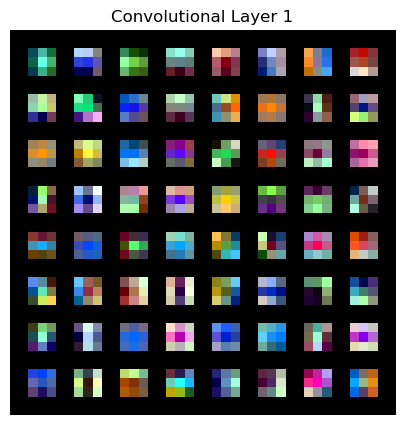

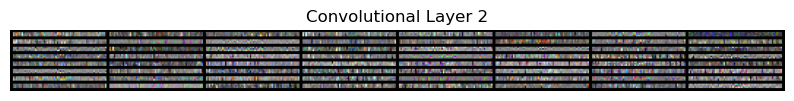

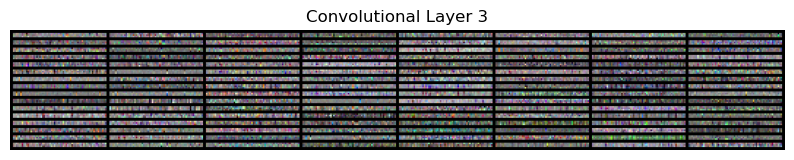

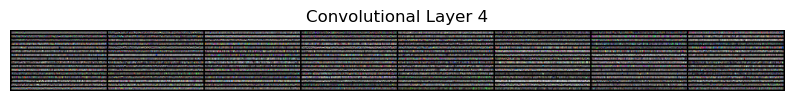

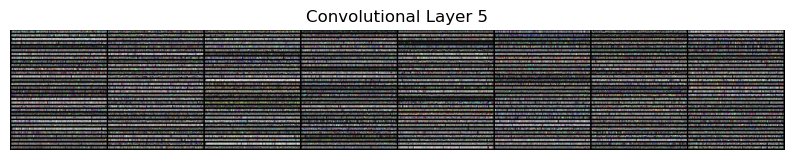

...

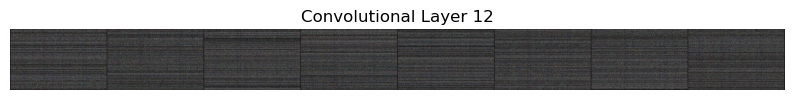

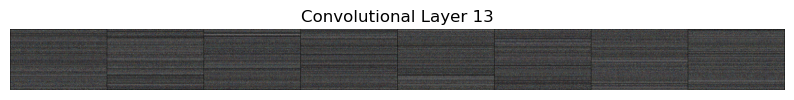

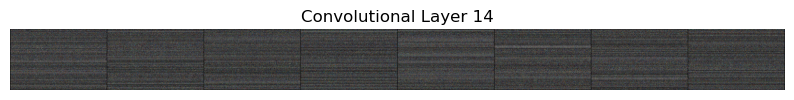

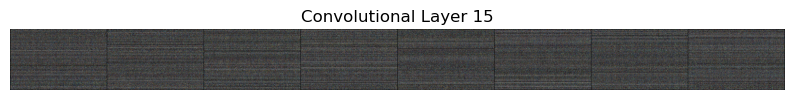

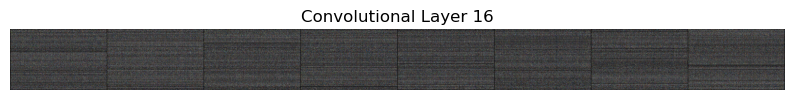

#######################################
 E X P E R I M E N T  7 E N D
#######################################
#######################################
 E X P E R I M E N T  8 S T A R T
#######################################
Experiment 8: Learning Rate (lr) = 0.001, Weight Decay (wd) = 0.01, Batch Size = 64
16


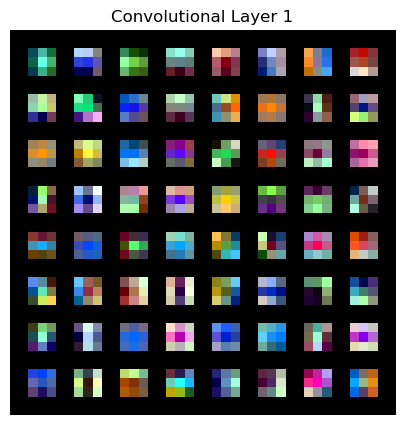

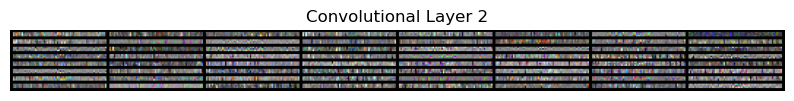

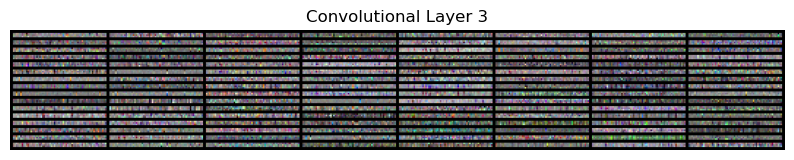

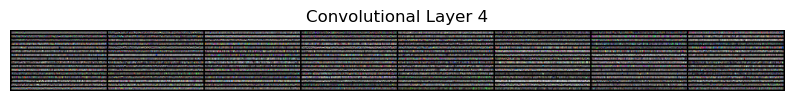

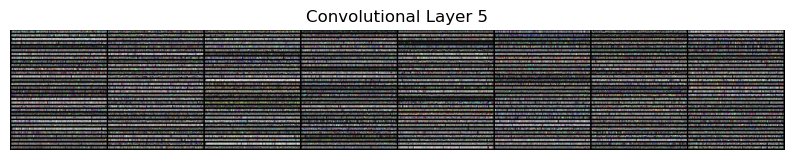

...

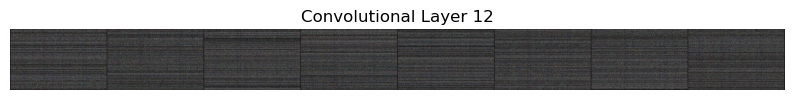

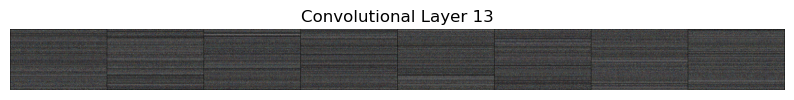

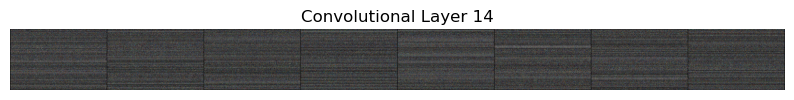

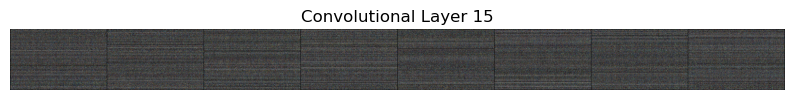

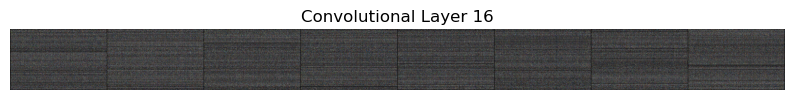

#######################################
 E X P E R I M E N T  8 E N D
#######################################
#######################################
 E X P E R I M E N T  9 S T A R T
#######################################
Experiment 9: Learning Rate (lr) = 0.01, Weight Decay (wd) = 0.001, Batch Size = 64
16


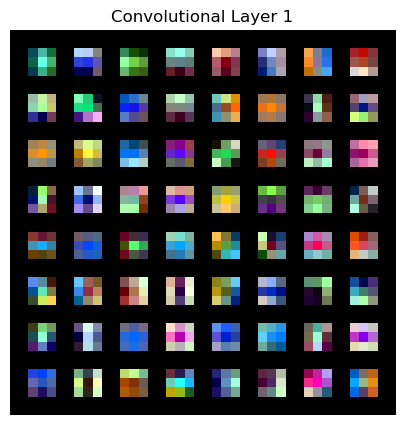

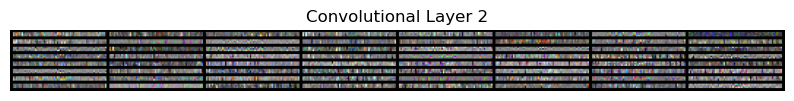

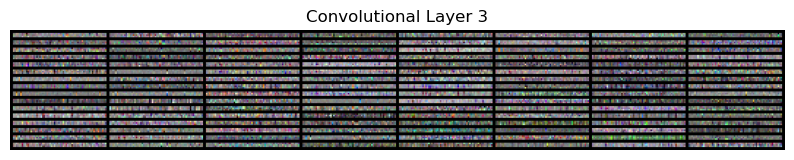

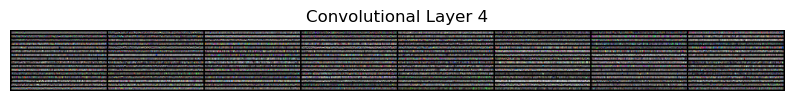

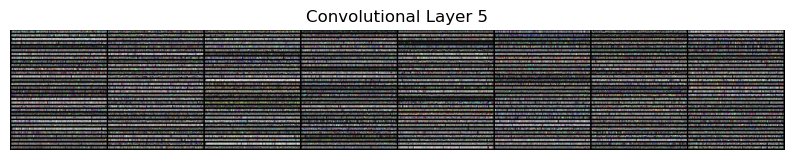

...

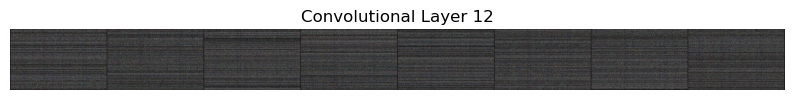

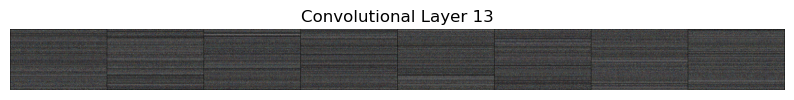

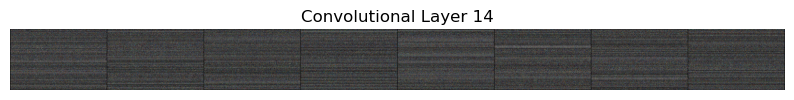

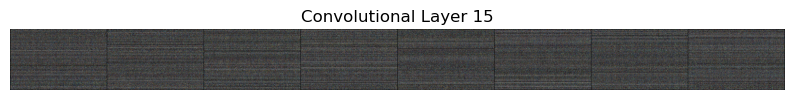

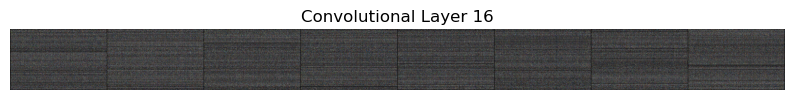

#######################################
 E X P E R I M E N T  9 E N D
#######################################
#######################################
 E X P E R I M E N T  10 S T A R T
#######################################
Experiment 10: Learning Rate (lr) = 0.001, Weight Decay (wd) = 0.001, Batch Size = 64
16


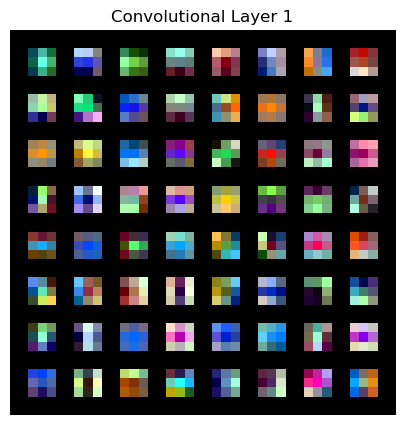

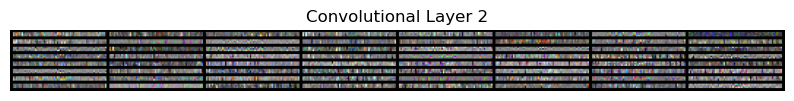

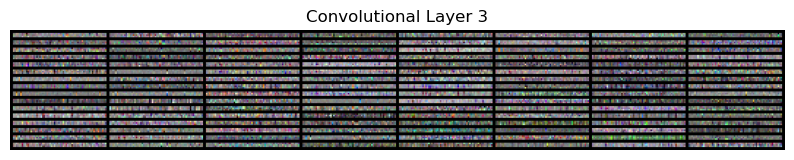

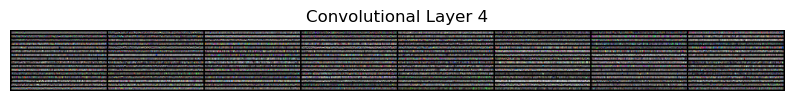

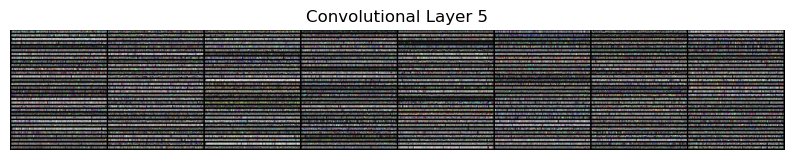

...

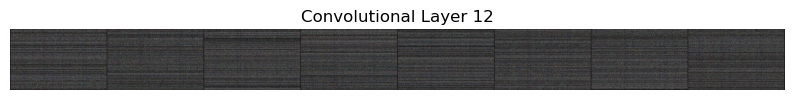

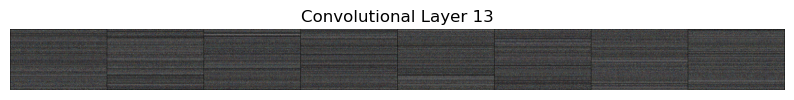

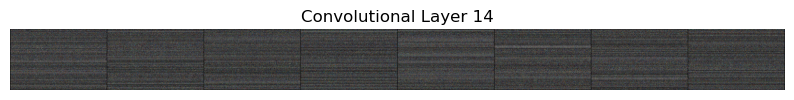

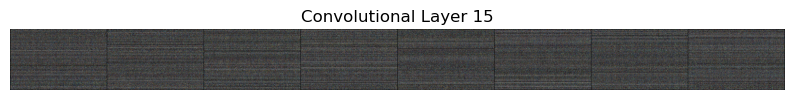

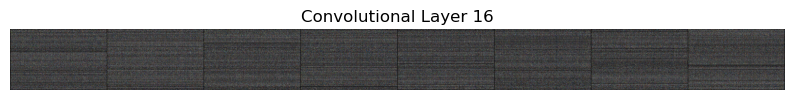

#######################################
 E X P E R I M E N T  10 E N D
#######################################
#######################################
 E X P E R I M E N T  11 S T A R T
#######################################
Experiment 11: Learning Rate (lr) = 0.001, Weight Decay (wd) = 0.001, Batch Size = 32
16


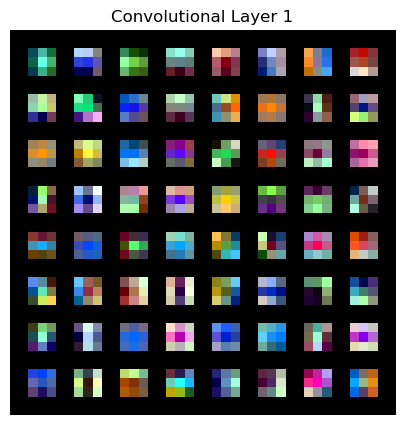

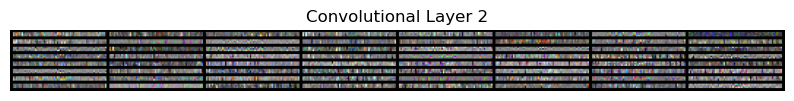

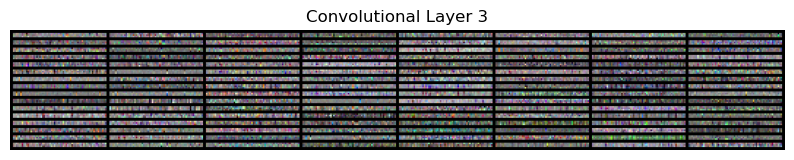

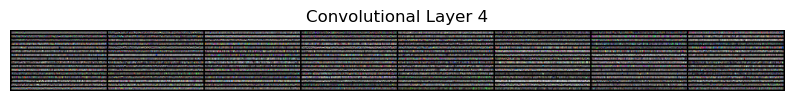

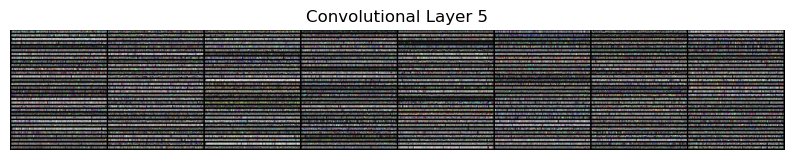

...

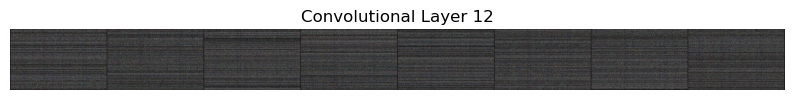

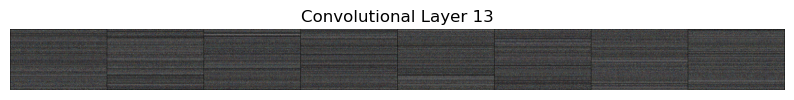

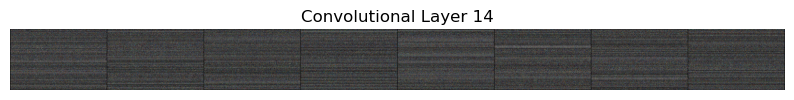

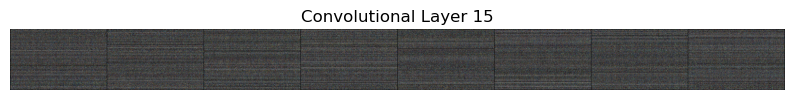

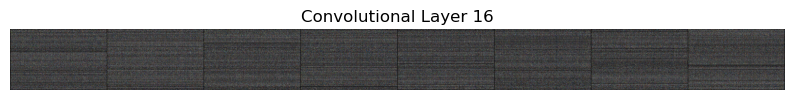

#######################################
 E X P E R I M E N T  11 E N D
#######################################
#######################################
 E X P E R I M E N T  12 S T A R T
#######################################
Experiment 12: Learning Rate (lr) = 0.01, Weight Decay (wd) = 0.01, Batch Size = 32
16


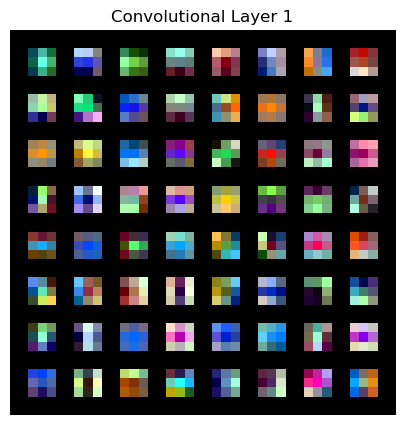

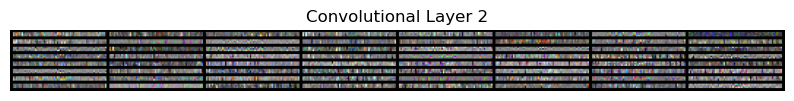

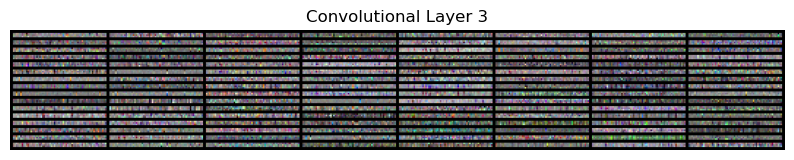

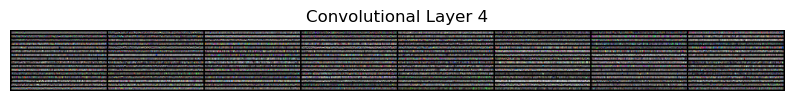

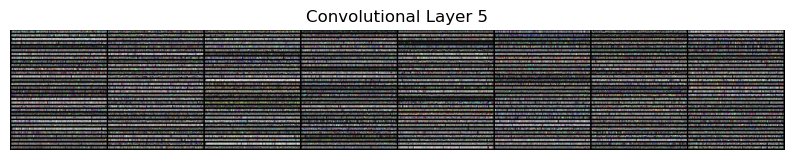

...

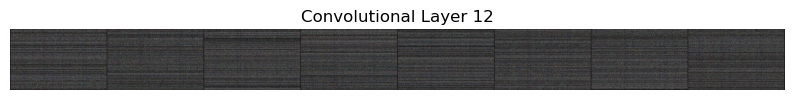

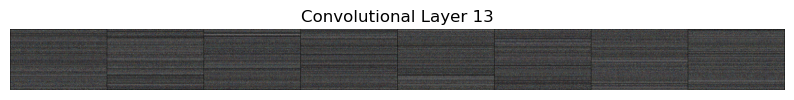

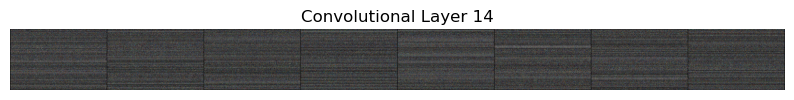

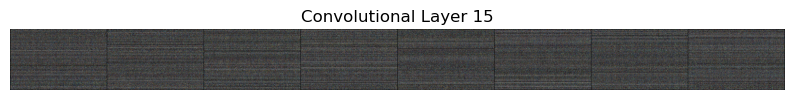

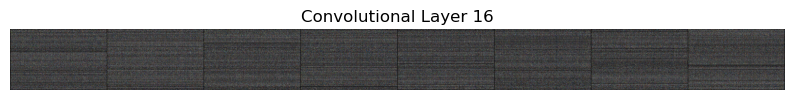

#######################################
 E X P E R I M E N T  12 E N D
#######################################


In [ ]:
for exp in experiment_steps:
    print("#######################################")
    print(f" E X P E R I M E N T  {exp['idx'] + 6} S T A R T")
    print("#######################################")
    print(f"Experiment {exp['idx'] + 6}: Learning Rate (lr) = {exp['lr']}, Weight Decay (wd) = {exp['wd']}, Batch Size = {exp['bs']}")

    vgg_19 = torch.load(fr'C:\Users\oguzh\Desktop\/vgg19_model{exp["idx"] + 6}.pth')

    conv_layers = [layer for layer in vgg_19.features if isinstance(layer, torch.nn.Conv2d)]

    print(len(conv_layers))

    # Iterate through convolutional layers
    for i, layer in enumerate(conv_layers):
        # Get the weights of the layer
        filters = layer.weight.data

        # Normalize and reshape filters for visualization
        filters = filters - filters.min()
        filters = filters / filters.max()

        # Move the tensor to the CPU before calling numpy()
        filters_cpu = filters.cpu().detach().numpy()

        # Reshape the filters to have a valid shape for visualization
        filters_reshaped = filters_cpu.transpose(0, 2, 3, 1)

        # Create a grid of filter images
        grid = torchvision.utils.make_grid(torch.from_numpy(filters_reshaped), nrow=8, normalize=True, scale_each=True)

        # Convert the grid to a NumPy array
        grid_np = grid.permute(1, 2, 0).numpy()

        # Plot the grid
        plt.figure(figsize=(10, 5))
        plt.imshow(grid_np)
        plt.title(f'Convolutional Layer {i+1}')
        plt.axis('off')
        plt.show()

    print("#######################################")
    print(f" E X P E R I M E N T  {exp['idx'] + 6} E N D")
    print("#######################################")

# Conclusion

**Architecture:**

- **VGG19:** It is a deep convolutional neural network with 19 layers, including 16 convolutional layers and 3 fully connected layers. The architecture follows a simple and uniform pattern, using small 3x3 filters throughout the convolutional layers, which allows for a deeper network.

- **Custom MLNN:** The architecture of a custom MLNN can be designed based on specific requirements. It typically includes an input layer, multiple hidden layers, and an output layer. The number of neurons, activation functions, and connectivity between layers can be customized. In our experiment, we customize these parameters and conduct experiments.

**Optimized Layers in VGG19:**

- **Task Flexibility**: The train_vgg19 function allows for two tasks: fine-tuning all weights or selectively optimizing the last two fully connected layers.

- **Efficient GPU Usage:** The code ensures accelerated training by moving the VGG19 model to the GPU.

- **Dynamic Learning:** Utilizing cross-entropy loss and SGD optimizer, the code adjusts hyperparameters such as learning rate, momentum, and weight decay.

- **Adaptive Learning Rate:** A step-wise learning rate scheduler dynamically refines the learning rate during training.

**Performance Metric Results:**

- While VGG19 achieves approximately 80% accuracy, precision, and recall values for the fully optimized model, and attains about 60% performance metrics by optimizing only the last 2 fully connected layers, the custom MLNN only achieves about a 10% performance metric. This suggests that using a CNN might be more effective for this particular task.

**Training Time:**

- VGG19: Training a deep architecture like VGG19 is computationally expensive and time-consuming due to its depth and the large number of parameters. It took about 20 hours to train for all 12 experiments on an above-average GPU.

- Custom MLNN: The training time for the Custom Multi-Layer Neural Network (MLNN) is significantly shorter than that of VGG-19. This efficiency stems from the custom MLNN's simpler architecture, featuring fewer hidden layers.

**Flexibility and Customization:**

- VGG19: While VGG19 provides a robust pre-defined architecture, it may not be as flexible for specific tasks or constraints as a custom MLNN. Fine-tuning is possible but might require more effort.

- Custom MLNN: It offers high flexibility, allowing for tailoring the architecture to the specific requirements of the task, potentially leading to better performance in certain scenarios.

**Resource Requirements:**

- VGG19: Due to its depth, VGG19 requires more computational resources like hardware and time, both during training and inference.

- Custom MLNN: Resource requirements can be adjusted based on the implementation, potentially making it more resource-efficient for specific applications.